# AUGMENTATION

No correr más después de tener el set, genera todas las imagenes que van a ser tratadas

In [2]:
from keras.preprocessing.image import ImageDataGenerator
from keras.utils.image_utils import img_to_array, array_to_img, load_img
import glob
import cv2
import numpy as np

datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=90,
    height_shift_range=90,
    shear_range=0,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

images_path = glob.glob("C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/*.jpg")

for img_path in images_path:
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    x = img_to_array(img_rgb)
    x = x.reshape((1,) + x.shape)
    i = 0
    for batch in datagen.flow(x, batch_size=1, save_to_dir='scanaugm',
                              save_prefix='test', save_format='jpeg'):
        i += 1
        if i > 4:
            break

# MOTION BLUR (NOT COMPROMISED TO USE IT)

In [8]:
# loading library
import cv2
import numpy as np
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)
img = cv2.imread('C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/scan (9).jpeg')
  
# Specify the kernel size.
# The greater the size, the more the motion.
kernel_size = 15
  
# Create the vertical kernel.
kernel_v = np.zeros((kernel_size, kernel_size))
  
# Create a copy of the same for creating the horizontal kernel.
kernel_h = np.copy(kernel_v)
  
# Fill the middle row with ones.
kernel_v[:, int((kernel_size - 1)/2)] = np.ones(kernel_size)
kernel_h[int((kernel_size - 1)/2), :] = np.ones(kernel_size)
# Normalize.
kernel_v /= kernel_size
kernel_h /= kernel_size
  
# Apply the vertical kernel.
vertical_mb = cv2.filter2D(img, -1, kernel_v)
  
# Apply the horizontal kernel.
horizonal_mb = cv2.filter2D(img, -1, kernel_h)
  
# Save the outputs.
cv2.imwrite('testimage.jpg', vertical_mb)
cv2.imwrite('testimage2.jpg', horizonal_mb)

True

# EDGES FOR EASY CASE (SCANNED)

In [ ]:
import glob
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
images_path = glob.glob("C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/*.jpeg")

for img_path in images_path:
    img = cv.imread(img_path)
    img = cv.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    assert img is not None, "El archivo no pudo ser leído, verifica con os.path.exists()"
    edges = cv.Canny(img, 100, 200)
    plt.subplot(121),plt.imshow(img,cmap = 'gray')
    plt.title('Original Image'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(edges,cmap = 'gray')
    plt.title('Edge Image'), plt.xticks([]), plt.yticks([])
    plt.show()


# DEFINITE LINE EXTRACTION METHOD

Este es el código básico sobre el cual se va a trabajar la extracción de lineas de las imágenes, a partir de acá se trata de desarrollar otras alternativas


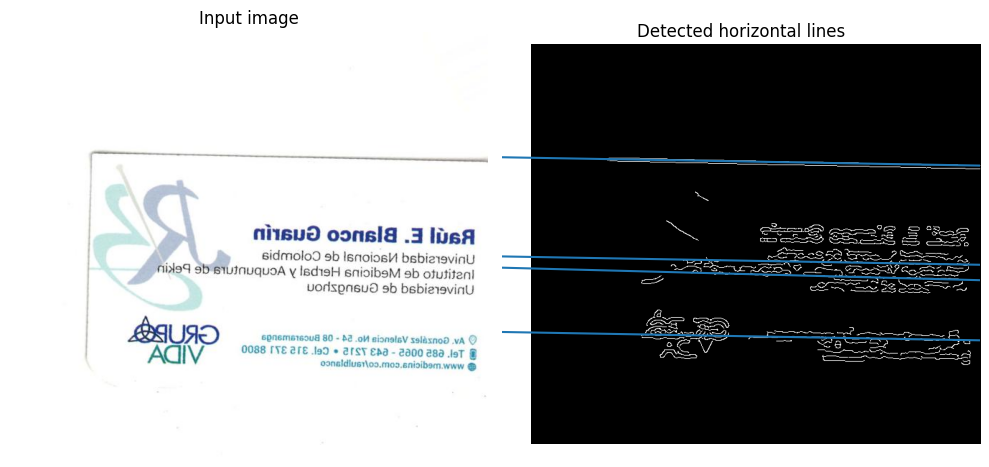

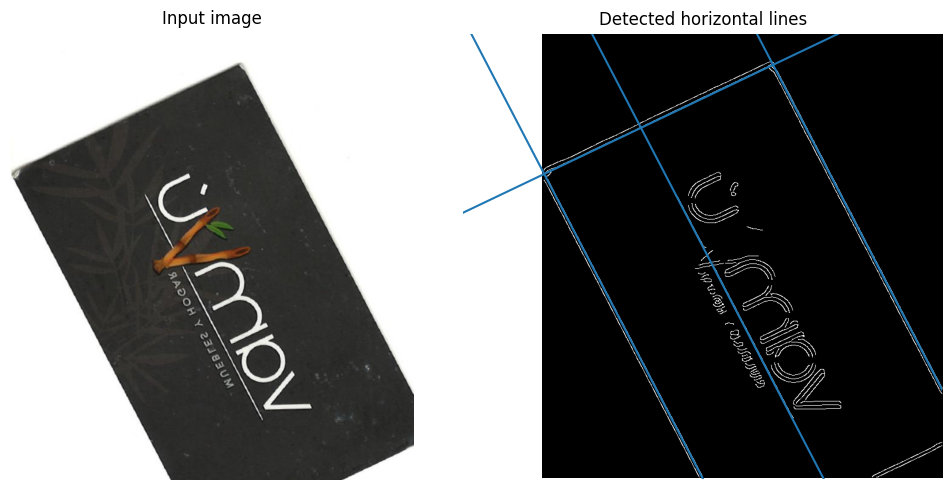

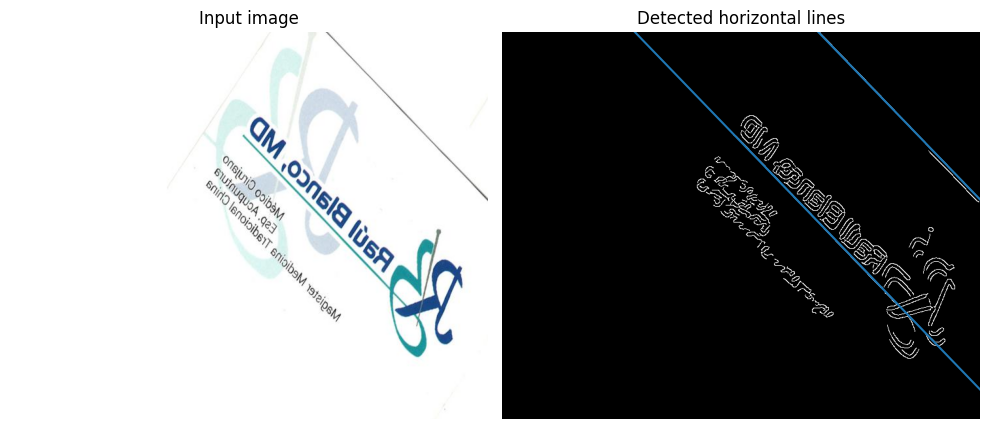

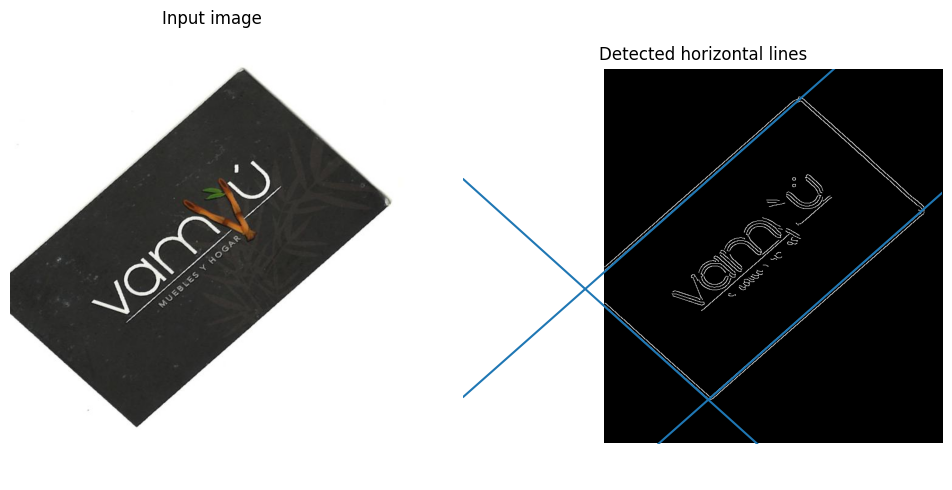

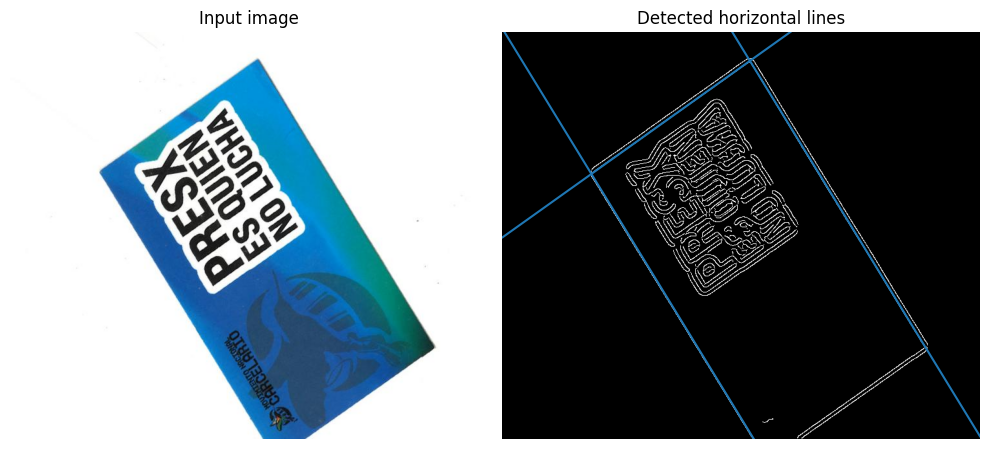

...

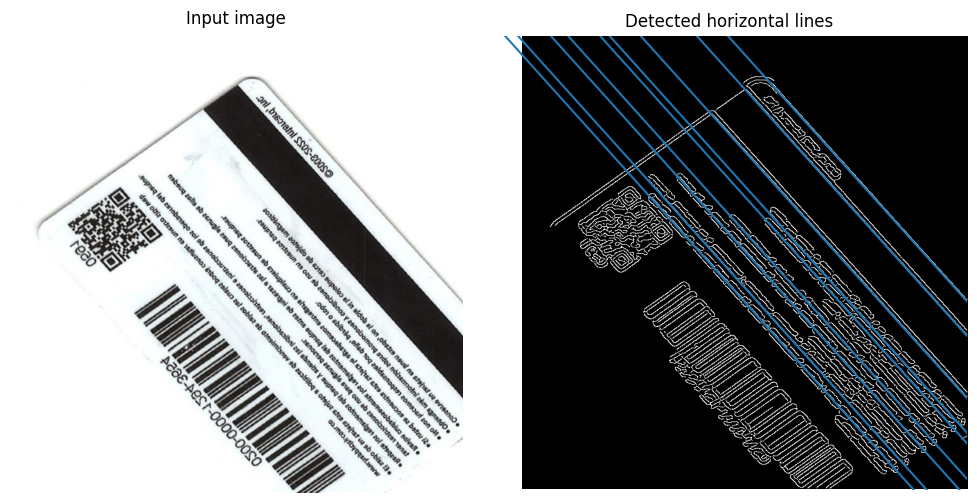

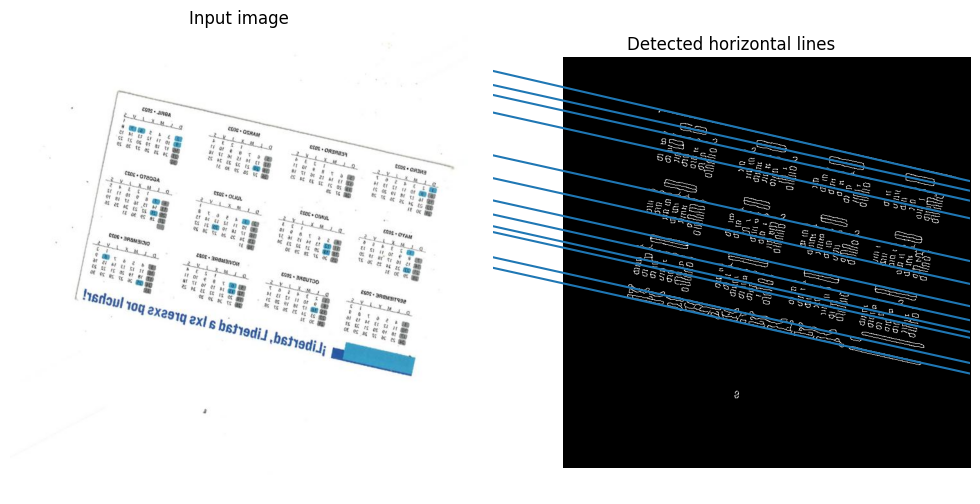

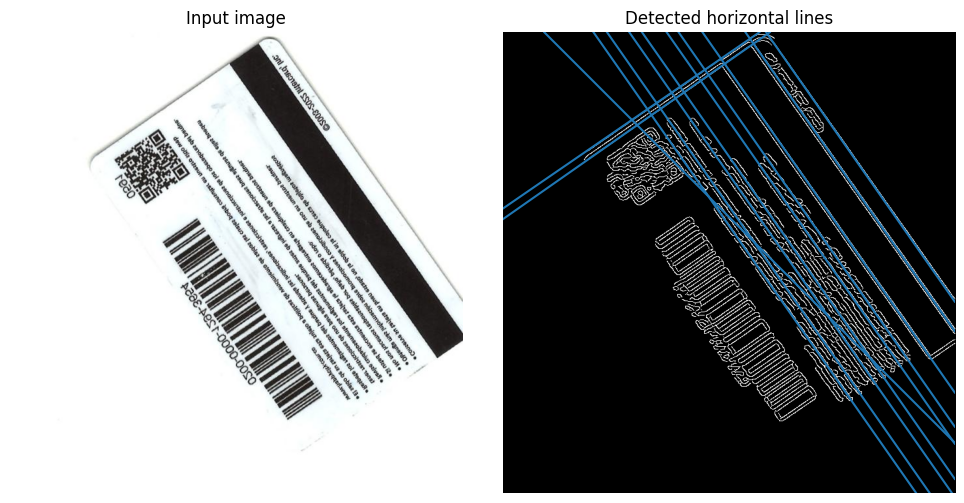

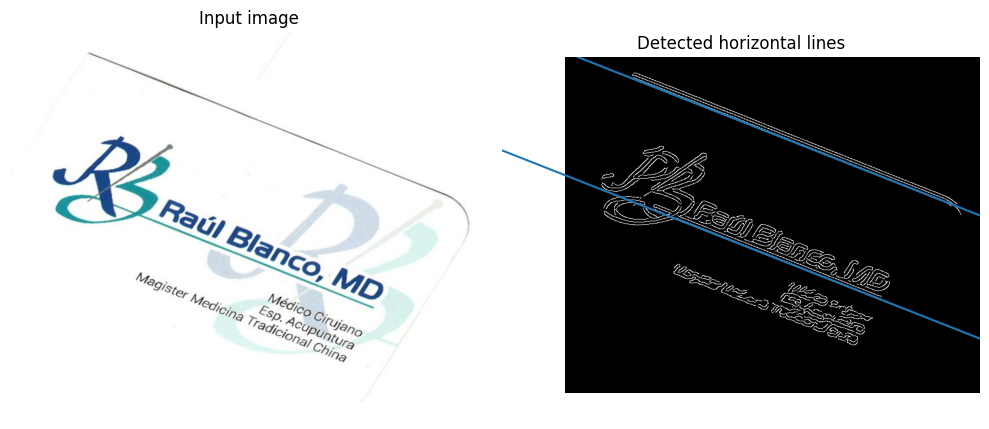

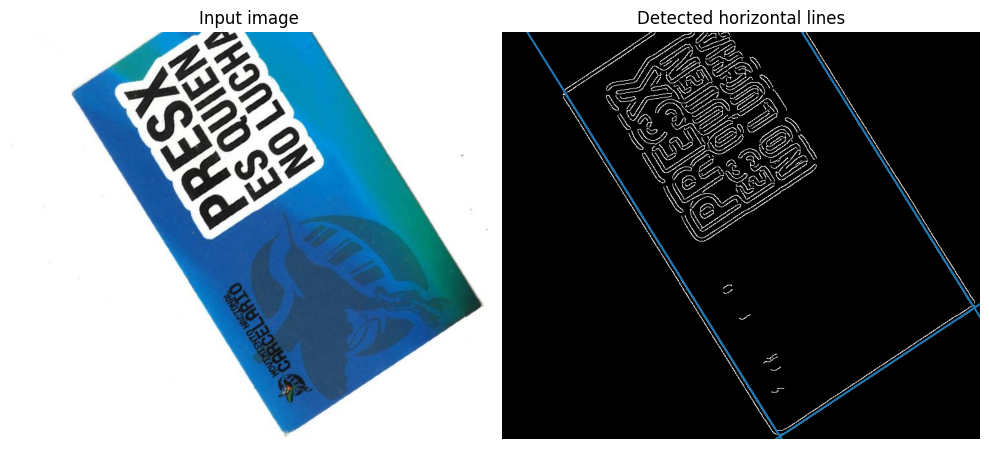

In [64]:
import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.feature import canny
from skimage import io, color, filters
import matplotlib.pyplot as plt
from matplotlib import cm
import glob

# Input path to the folder containing images
image_folder = "C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/"

# Retrieve a list of image file paths in the folder
image_paths = glob.glob(image_folder + "*.jpeg")  # Update the file extension if necessary

# Process each image in the folder
for image_path in image_paths:
    # Load the source image
    image = io.imread(image_path)

    # Convert the image to grayscale
    image_gray = color.rgb2gray(image)

    # Apply Gaussian blur to reduce noise
    image_blurred = filters.gaussian(image_gray, sigma=1.5)

    # Apply horizontal Sobel filter
    image_edges_h = filters.sobel_h(image_blurred)

    # Perform Canny edge detection on horizontal Sobel output
    edges_h = canny(image_edges_h, sigma=1.8)

    # Perform Hough transform on the horizontal edges
    tested_angles_h = np.linspace(0, np.pi, 360, endpoint=False)
    h_h, theta_h, d_h = hough_line(edges_h, theta=tested_angles_h)


    # Plot the input image and the detected horizontal lines
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    ax = axes.ravel()

    ax[0].imshow(image, cmap=cm.gray)
    ax[0].set_title('Input image')
    ax[0].set_axis_off()

    ax[1].imshow(edges_h, cmap=cm.gray)
    ax[1].set_ylim((edges_h.shape[0], 0))
    ax[1].set_axis_off()
    ax[1].set_title('Detected horizontal lines')

    for _, angle, dist in zip(*hough_line_peaks(h_h, theta_h, d_h)):
        (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
        ax[1].axline((x0, y0), slope=np.tan(angle + np.pi/2))

    plt.tight_layout()
    plt.show()


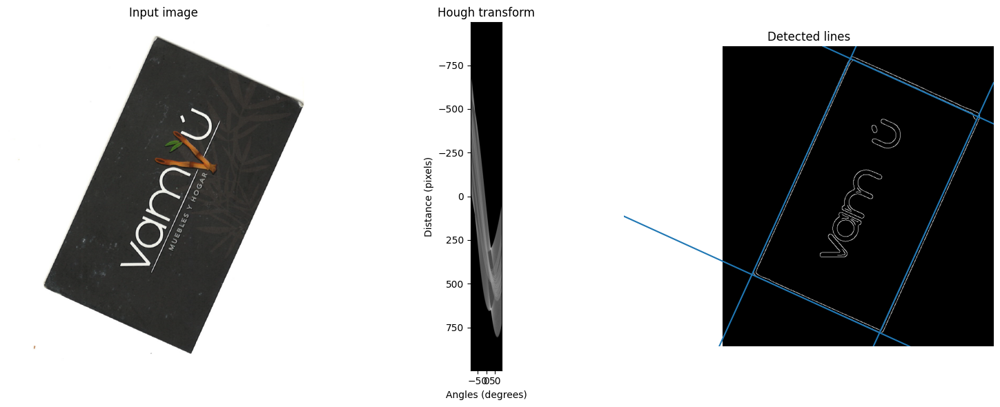

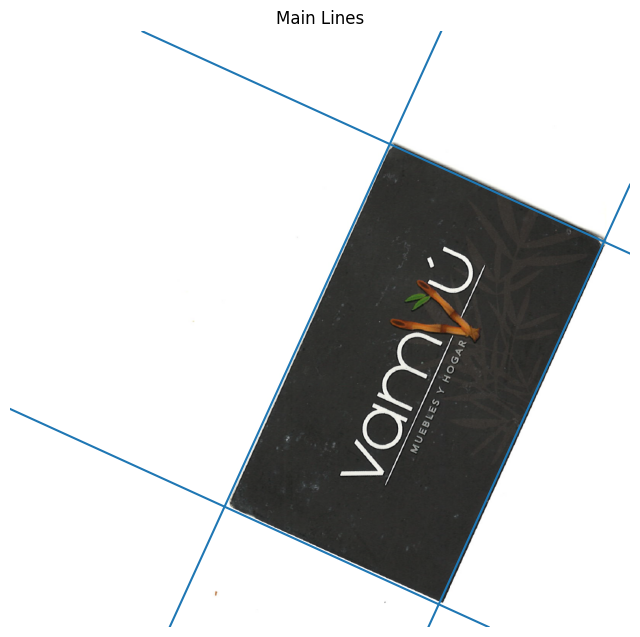

In [65]:

import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.feature import canny
from skimage.draw import line as draw_line
from skimage import data, io, color, filters
import matplotlib.pyplot as plt
from matplotlib import cm

# Load the source image
image = io.imread("C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/scan (2).jpg")  
# Replace 'path_to_image.jpg' with the actual path to your image

# Convert the image to grayscale
image_gray = color.rgb2gray(image)

# Apply Gaussian blur to reduce noise
image_blurred = filters.gaussian(image_gray, sigma=1.5)

# Enhance edges using Sobel filter
image_edges = filters.sobel(image_blurred)

# Perform Canny edge detection
edges = canny(image_edges, sigma=2.0)

# Perform Hough transform on the edges
tested_angles = np.linspace(-np.pi / 2, np.pi / 2, 360, endpoint=False)
h, theta, d = hough_line(edges, theta=tested_angles)

fig, axes = plt.subplots(1, 3, figsize=(15, 6))
ax = axes.ravel()

ax[0].imshow(image, cmap=cm.gray)
ax[0].set_title('Input image')
ax[0].set_axis_off()

angle_step = 0.5 * np.diff(theta).mean()
d_step = 0.5 * np.diff(d).mean()
bounds = [np.rad2deg(theta[0] - angle_step),
          np.rad2deg(theta[-1] + angle_step),
          d[-1] + d_step, d[0] - d_step]
ax[1].imshow(np.log(1 + h), extent=bounds, cmap=cm.gray, aspect=1 / 1.5)
ax[1].set_title('Hough transform')
ax[1].set_xlabel('Angles (degrees)')
ax[1].set_ylabel('Distance (pixels)')
ax[1].axis('image')

ax[2].imshow(edges, cmap=cm.gray)
ax[2].set_ylim((edges.shape[0], 0))
ax[2].set_axis_off()
ax[2].set_title('Detected lines')

main_line_angles = []  # Store the angles of the main lines

for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
    (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
    ax[2].axline((x0, y0), slope=np.tan(angle + np.pi / 2))
    
    main_line_angles.append(angle)

plt.tight_layout()
plt.show()

# Calculate the average angle of all the lines
average_angle = np.mean(main_line_angles)

# Sort the main line angles based on their proximity to average_angle
main_line_angles.sort(key=lambda x: np.abs(x - average_angle))

# Set the number of lines to be selected from each set
num_lines_per_set = 1

# Create sets A and B for main lines
set_A = main_line_angles[:num_lines_per_set]
set_B = main_line_angles[-num_lines_per_set:]

# Check if set A or set B has only one line detected
if len(set_A) < num_lines_per_set:
    set_A.append(set_B[0])  # Add a line from set B to set A
if len(set_B) < num_lines_per_set:
    set_B.append(set_A[0])  # Add a line from set A to set B

# Display the main lines from sets A and B
fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(image, cmap=cm.gray)
ax.set_title('Main Lines')
ax.set_axis_off()

for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
    if np.isclose(angle, set_A[0]) or np.isclose(angle, set_B[0]):
        (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
        ax.axline((x0, y0), slope=np.tan(angle + np.pi / 2))

plt.show()




# TRABAJANDO CON LINEAS PRINCIPALES

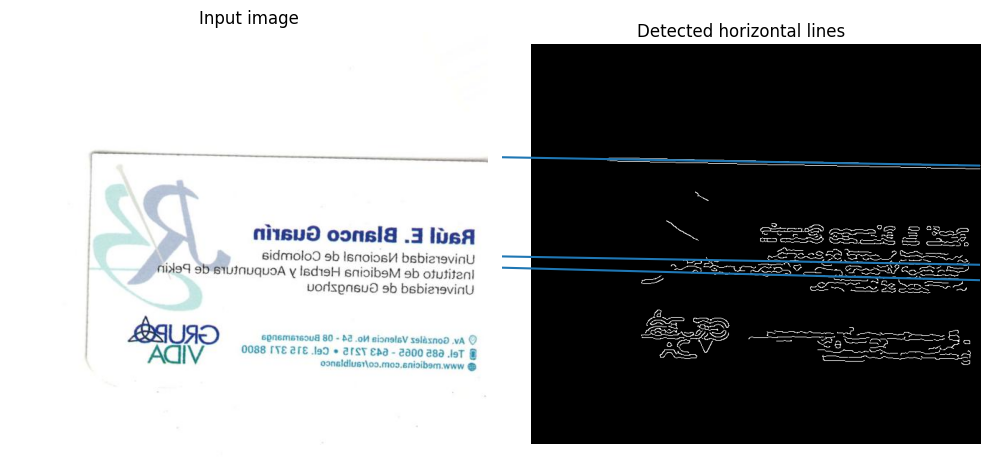

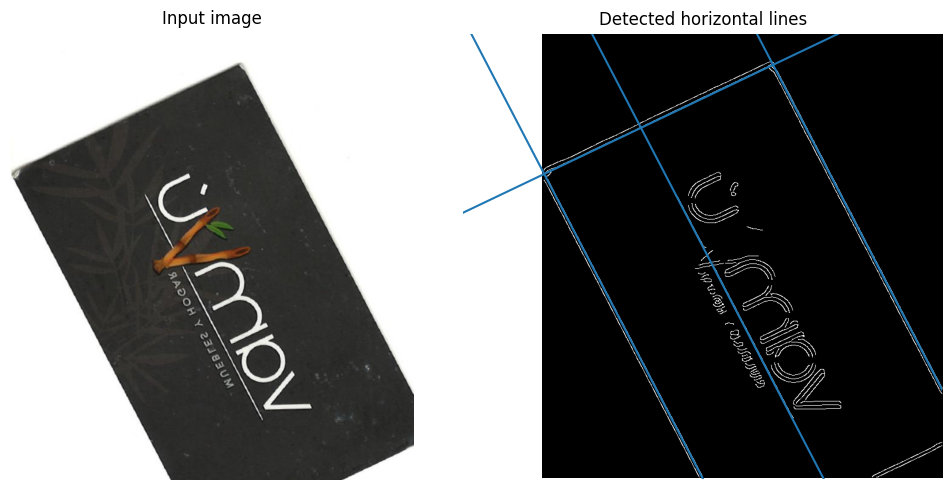

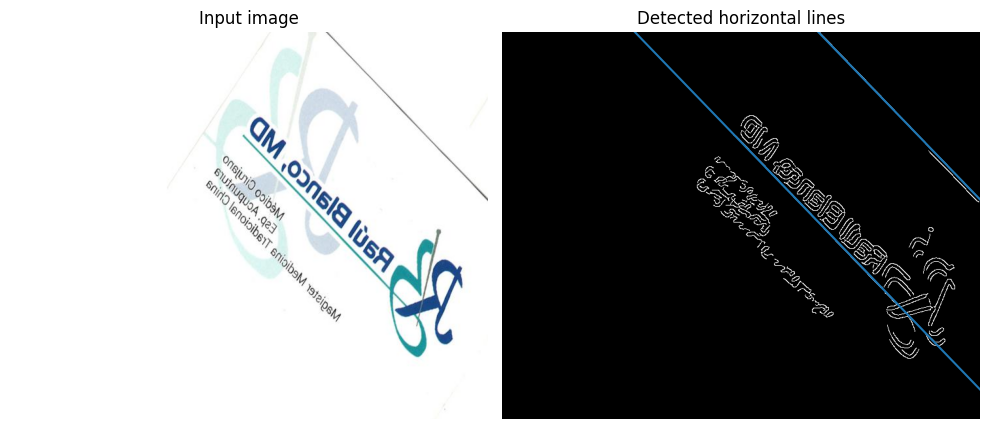

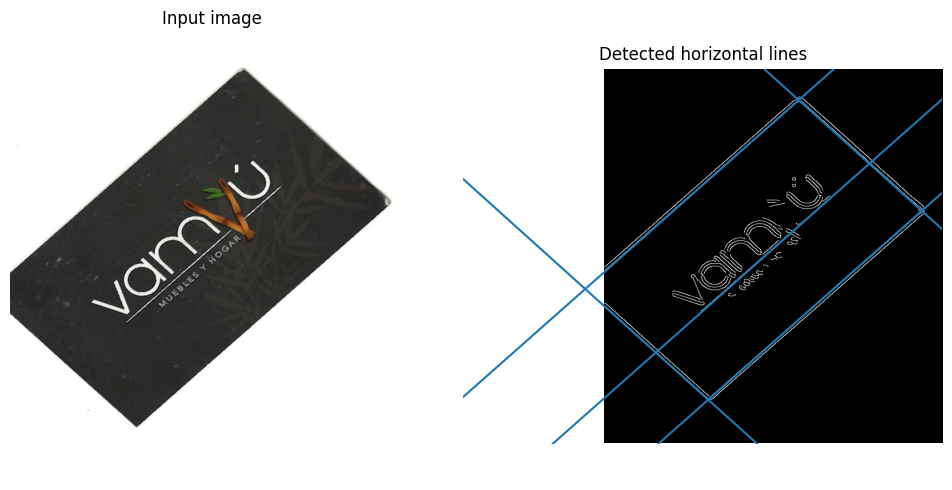

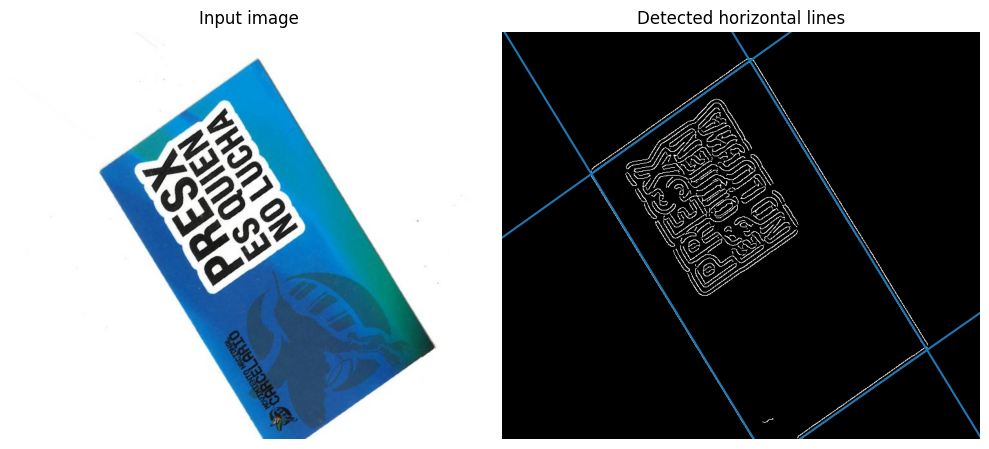

...

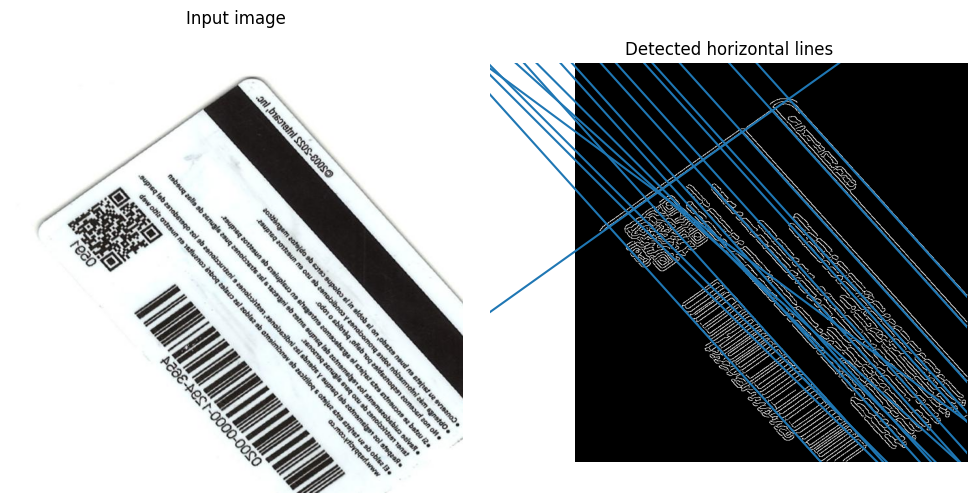

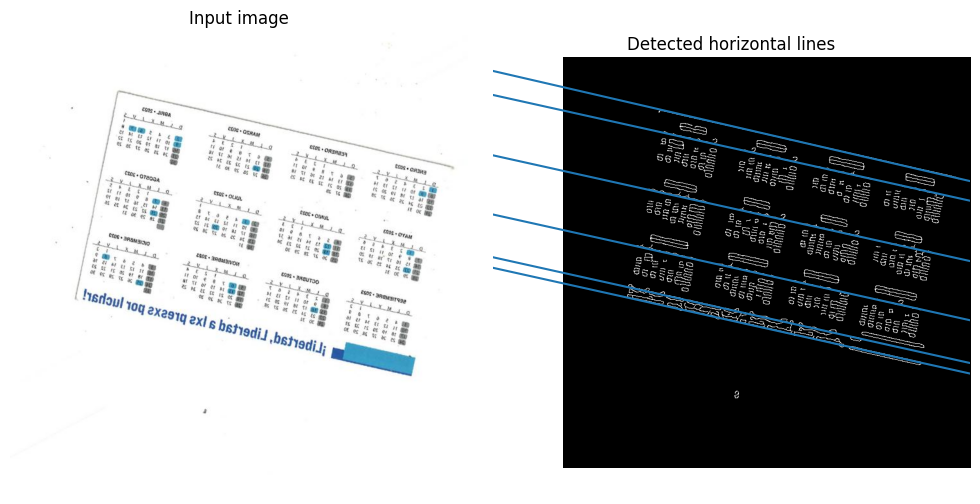

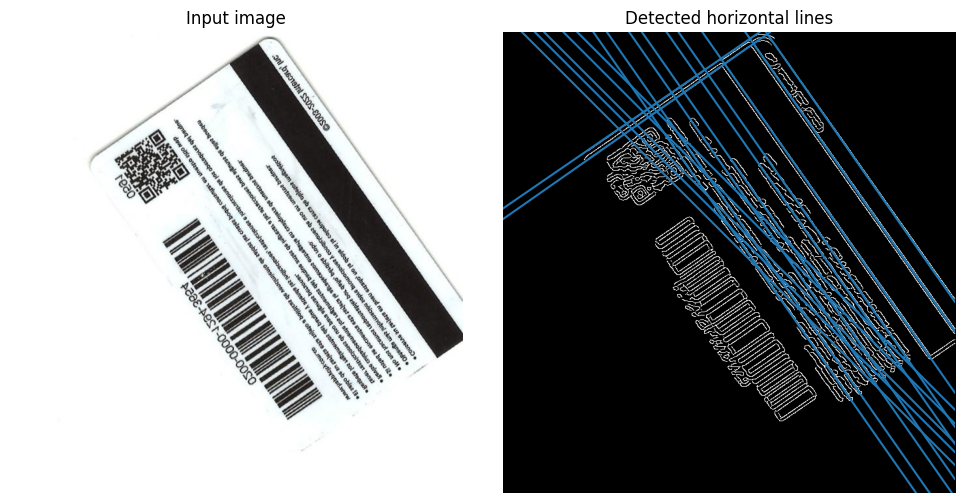

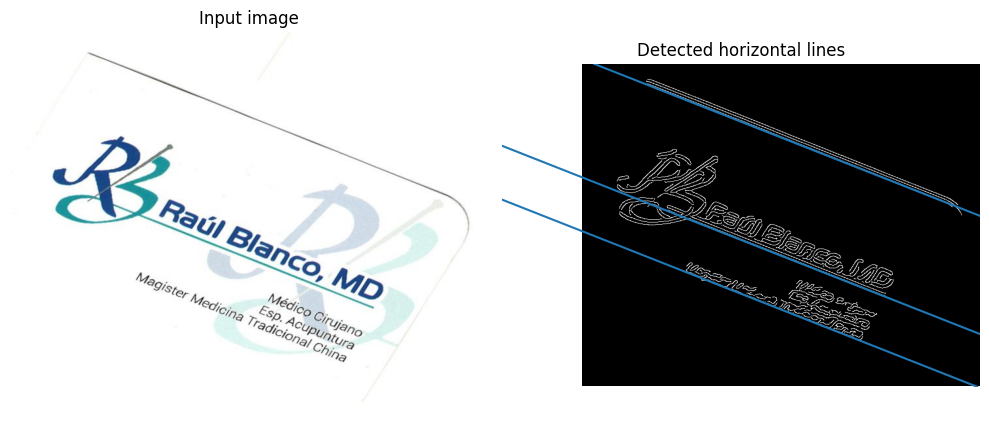

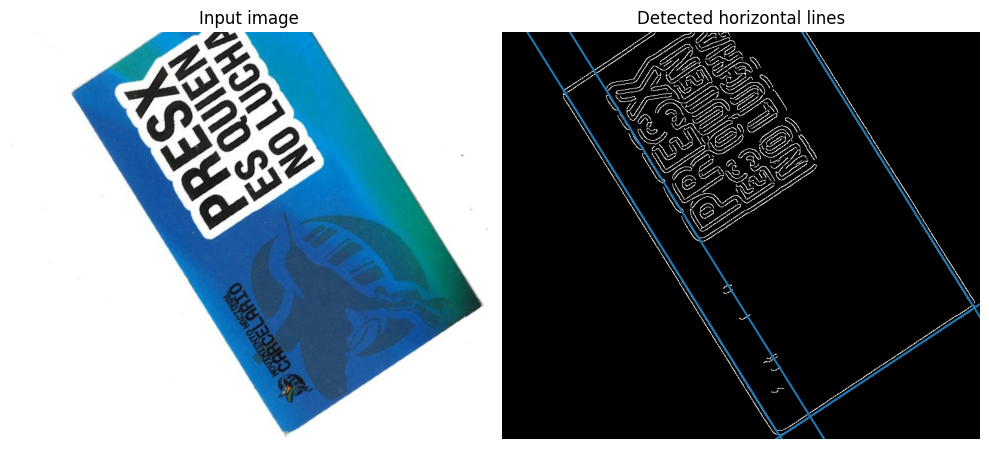

In [66]:
import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.feature import canny
from skimage import io, color, filters
import matplotlib.pyplot as plt
from matplotlib import cm
import glob

# Input path to the folder containing images
image_folder = "C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/"

# Retrieve a list of image file paths in the folder
image_paths = glob.glob(image_folder + "*.jpeg")  # Update the file extension if necessary

# Process each image in the folder
for image_path in image_paths:
    # Load the source image
    image = io.imread(image_path)

    # Convert the image to grayscale
    image_gray = color.rgb2gray(image)

    # Apply Gaussian blur to reduce noise
    image_blurred = filters.gaussian(image_gray, sigma=1.5)

    # Apply horizontal Sobel filter
    image_edges_h = filters.sobel_h(image_blurred)

    # Perform Canny edge detection on horizontal Sobel output
    edges_h = canny(image_edges_h, sigma=1.8)

    # Perform Hough transform on the horizontal edges
    tested_angles_h = np.linspace(0, np.pi, 360, endpoint=False)
    h_h, theta_h, d_h = hough_line(edges_h, theta=tested_angles_h)

    # Extract prominent lines from the Hough accumulator using a threshold
    _, angles, distances = hough_line_peaks(h_h, theta_h, d_h, threshold=160)

    # Plot the input image and the detected horizontal lines
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    ax = axes.ravel()

    ax[0].imshow(image, cmap=cm.gray)
    ax[0].set_title('Input image')
    ax[0].set_axis_off()

    ax[1].imshow(edges_h, cmap=cm.gray)
    ax[1].set_ylim((edges_h.shape[0], 0))
    ax[1].set_axis_off()
    ax[1].set_title('Detected horizontal lines')

    for angle, dist in zip(angles, distances):
        (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
        ax[1].axline((x0, y0), slope=np.tan(angle + np.pi/2))

    plt.tight_layout()
    plt.show()


# CODIGO GENERADO CON CHAT GPT PARA ENTENDER AGRUPAMIENTO 

Planteado para agrupar los angulos de las lineas principales con respecto a un angulo central y una tolerancia

In [7]:
import numpy as np
from sklearn.cluster import KMeans


angles = np.array([80, 81, 79, 80.5, 20, 19, 19.8, 23])

# Perform K-means clustering to find the main angles
kmeans = KMeans(n_clusters=2, random_state=0).fit(angles.reshape(-1, 1))
main_angles = kmeans.cluster_centers_.flatten()

means = []
for main_angle in main_angles:
    # Find indices of angles close to the main angle
    indices = np.where(np.isclose(angles, main_angle, atol=1.0))[0]
    # Calculate the mean of angles close to the main angle
    mean_angle = np.mean(angles[indices])
    means.append(mean_angle)

print("Main angles:", main_angles)
print("Means of angles close to the main angles:", means)


Main angles: [20.45  80.125]
Means of angles close to the main angles: [19.9, 80.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


[ 39.5  39.5  39.5  39.5  39.5  39.5  39.5  39.5 129.5  39.5  45.   39.5
  45.   39.5]
Main angles (degrees): [ 40.34615385 129.5       ]
Means of angles close to the main angles (degrees): [ 40.34615385 129.5       ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


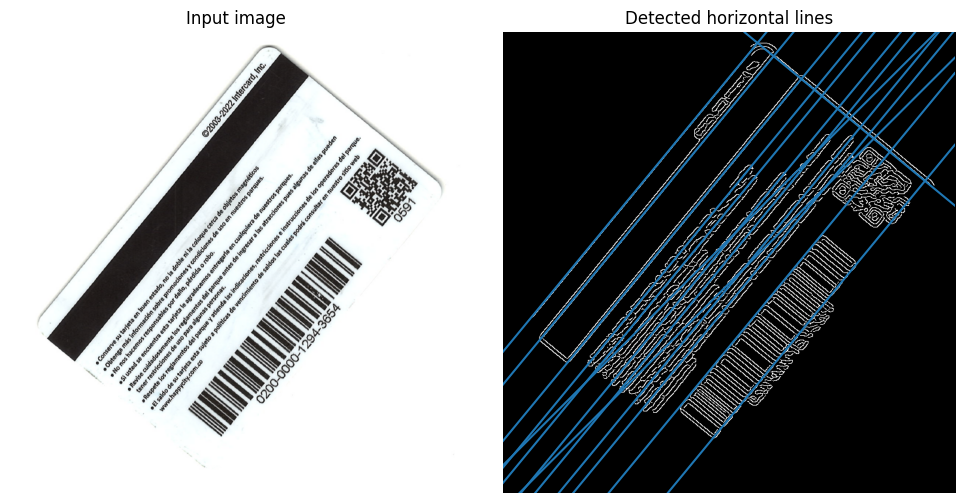

In [27]:
import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.feature import canny
from skimage import io, color, filters
import matplotlib.pyplot as plt
from matplotlib import cm
from sklearn.cluster import KMeans

# Input path to the single image
image_path = "C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scan/scan (8).jpg"

# Load the source image
image = io.imread(image_path)

# Convert the image to grayscale
image_gray = color.rgb2gray(image)

# Apply Gaussian blur to reduce noise
image_blurred = filters.gaussian(image_gray, sigma=1.5)

# Apply horizontal Sobel filter
image_edges_h = filters.sobel_h(image_blurred)

# Perform Canny edge detection on horizontal Sobel output
edges_h = canny(image_edges_h, sigma=1.8)

# Perform Hough transform on the horizontal edges
tested_angles_h = np.linspace(0, np.pi, 360, endpoint=False)
h_h, theta_h, d_h = hough_line(edges_h, theta=tested_angles_h)

# Extract prominent lines from the Hough accumulator using a threshold
_, angles, distances = hough_line_peaks(h_h, theta_h, d_h, threshold=160)
print(np.rad2deg(angles))
# Perform K-means clustering to find the main angles
if len(angles) > 1:
    kmeans = KMeans(n_clusters=2, random_state=0).fit(angles.reshape(-1, 1))
    main_angles = kmeans.cluster_centers_.flatten()
else:
    main_angles = angles

# Calculate the means of angles close to the main angles
means = []
for main_angle in main_angles:
    # Find indices of angles close to the main angle
    indices = np.where(np.isclose(angles, main_angle, atol=1.0))[0]
    # Calculate the mean of angles close to the main angle
    mean_angle = np.mean(angles[indices])
    means.append(mean_angle)

# Convert main_angles and means to degrees
main_angles_deg = np.rad2deg(main_angles)
means_deg = np.rad2deg(means)

print("Main angles (degrees):", main_angles_deg)
print("Means of angles close to the main angles (degrees):", means_deg)

# Plot the input image and the detected horizontal lines
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
ax = axes.ravel()

ax[0].imshow(image, cmap=cm.gray)
ax[0].set_title('Input image')
ax[0].set_axis_off()

ax[1].imshow(edges_h, cmap=cm.gray)
ax[1].set_ylim((edges_h.shape[0], 0))
ax[1].set_axis_off()
ax[1].set_title('Detected horizontal lines')

for angle, dist in zip(angles, distances):
    (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
    ax[1].axline((x0, y0), slope=np.tan(angle + np.pi/2))

plt.tight_layout()
plt.show()







[61.5 61.5 61.5]
testing main   [61.5 61.5]
Main angles (degrees): [ 40.34615385 129.5       ]
Means of angles close to the main angles (degrees): [ 40.34615385 129.5       ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


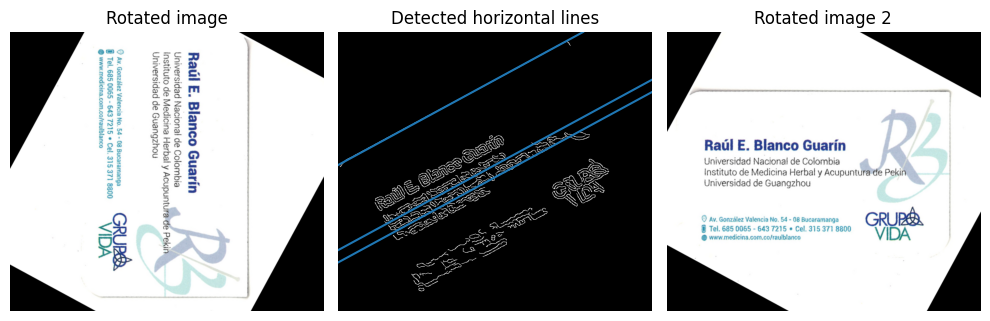

In [59]:
import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.feature import canny
from skimage import io, color, filters
import matplotlib.pyplot as plt
from matplotlib import cm
from sklearn.cluster import KMeans

# Function to rotate an image clockwise
def rotate_clockwise(image, degrees):
    height, width = image.shape[:2]
    center = (width / 2, height / 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, -degrees, 1.0)
    rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))
    return rotated_image

# Input path to the single image
image_path = "C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scan/scan (1).jpg"

# Load the source image
image = io.imread(image_path)

# Convert the image to grayscale
image_gray = color.rgb2gray(image)

# Apply Gaussian blur to reduce noise
image_blurred = filters.gaussian(image_gray, sigma=1.5)

# Apply horizontal Sobel filter
image_edges_h = filters.sobel_h(image_blurred)

# Perform Canny edge detection on horizontal Sobel output
edges_h = canny(image_edges_h, sigma=1.8)

# Perform Hough transform on the horizontal edges
tested_angles_h = np.linspace(0, np.pi, 360, endpoint=False)
h_h, theta_h, d_h = hough_line(edges_h, theta=tested_angles_h)

# Extract prominent lines from the Hough accumulator using a threshold
_, angles, distances = hough_line_peaks(h_h, theta_h, d_h, threshold=160)
print(np.rad2deg(angles))
# Perform K-means clustering to find the main angles
if len(angles) > 1:
    kmeans = KMeans(n_clusters=2, random_state=0).fit(angles.reshape(-1, 1))
    main_angles = kmeans.cluster_centers_.flatten()
else:
    main_angles = angles
print('testing main  ',np.rad2deg(main_angles))
main_angles=np.rad2deg(main_angles)
# Calculate the means of angles close to the main angles
means = []
#for main_angle in main_angles:
    # Find indices of angles close to the main angle
 #   indices = np.where(np.isclose(angles, main_angle, atol=1.0))[0]
    # Calculate the mean of angles close to the main angle
  #  mean_angle = np.mean(angles[indices])
   # means.append(mean_angle)

# Convert main_angles and means to degrees
#main_angles_deg = np.rad2deg(main_angles)
#means_deg = np.rad2deg(means)

print("Main angles (degrees):", main_angles_deg)
print("Means of angles close to the main angles (degrees):", means_deg)

# Rotate the image clockwise by 90 degrees
rotated_image = rotate_clockwise(image, 180-main_angles[1])
rotated_image2=rotate_clockwise(image, 90-main_angles[0])
# Plot the input image and the detected horizontal lines
fig, axes = plt.subplots(1, 3, figsize=(10, 5))
ax = axes.ravel()

ax[0].imshow(rotated_image, cmap=cm.gray)  # Display the rotated image
ax[0].set_title('Rotated image')
ax[0].set_axis_off()

ax[1].imshow(edges_h, cmap=cm.gray)
ax[1].set_ylim((edges_h.shape[0], 0))
ax[1].set_axis_off()
ax[1].set_title('Detected horizontal lines')


ax[2].imshow(rotated_image2, cmap=cm.gray)  # Display the rotated image
ax[2].set_title('Rotated image 2')
ax[2].set_axis_off()
for angle, dist in zip(angles, distances):
    (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
    ax[1].axline((x0, y0), slope=np.tan(angle + np.pi/2))

plt.tight_layout()
plt.show()



[91.  91.  91.5]
testing main   [91.  91.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


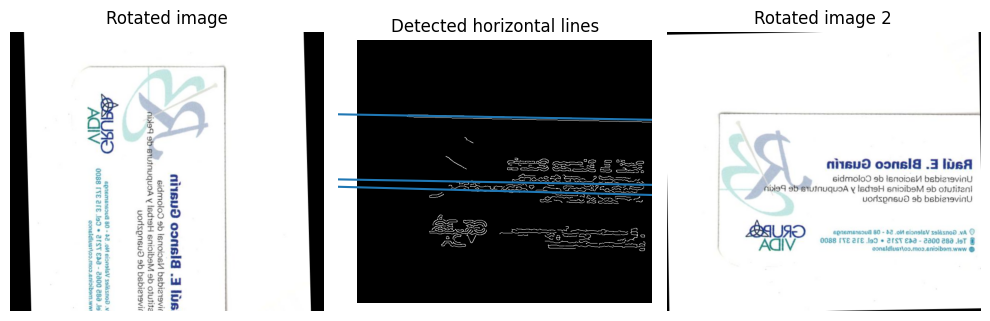

[152.5 152.5  64.5 152.5]
testing main   [ 64.5 152.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


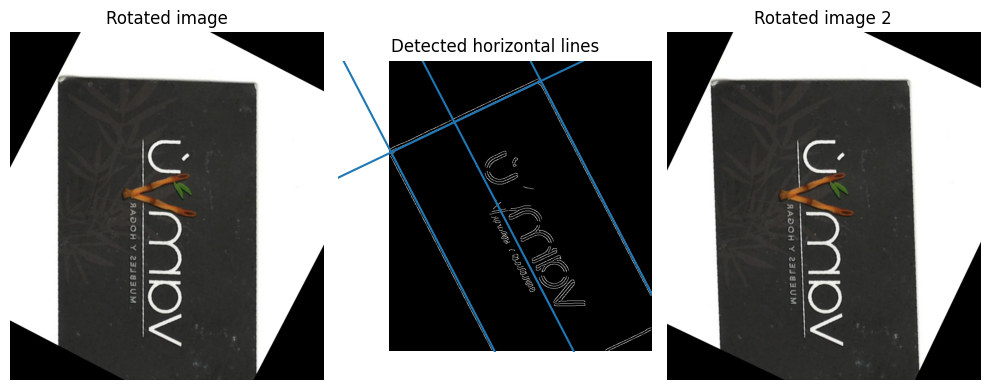

[136. 136.]
testing main   [136. 136.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


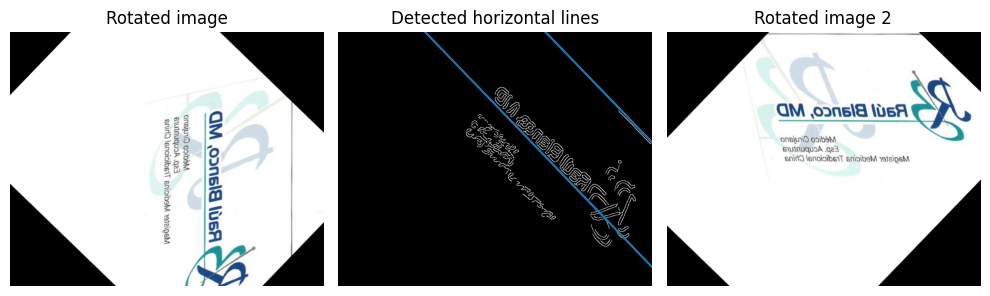

[ 48.5  48.5 132.  132.   48.5]
testing main   [132.   48.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


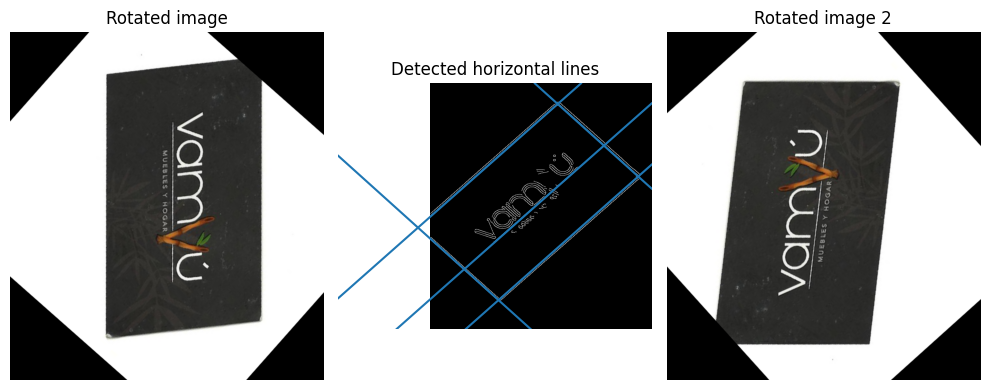

[148.5 148.5  54.5  55. ]
testing main   [ 54.75 148.5 ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


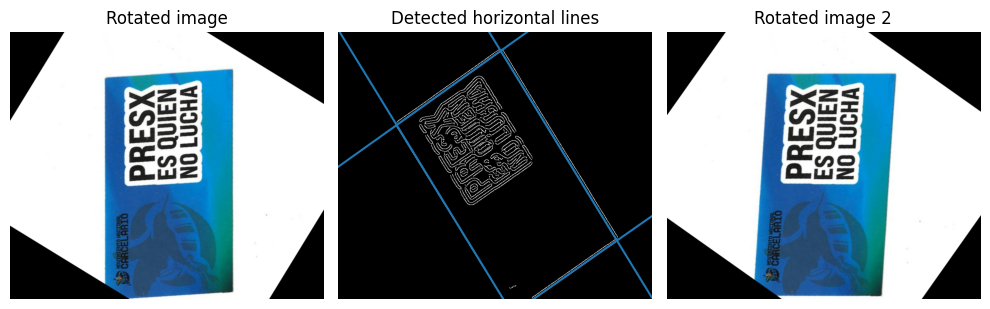

[83.5 83.5]
testing main   [83.5 83.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


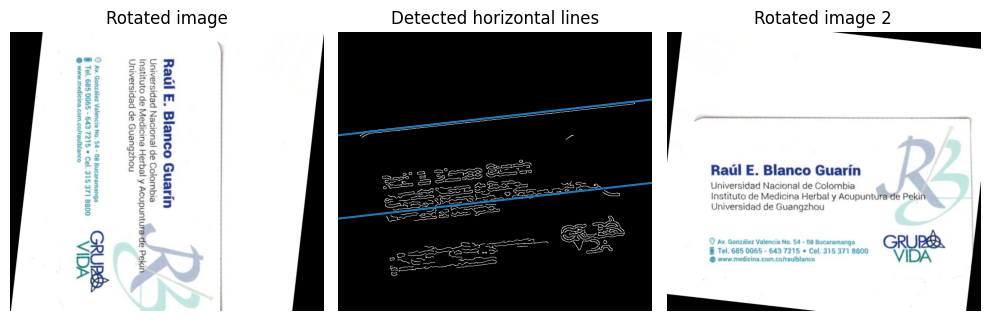

[71. 71. 71. 71. 71. 71. 71. 71. 71. 71. 71. 71.]
testing main   [71. 71.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


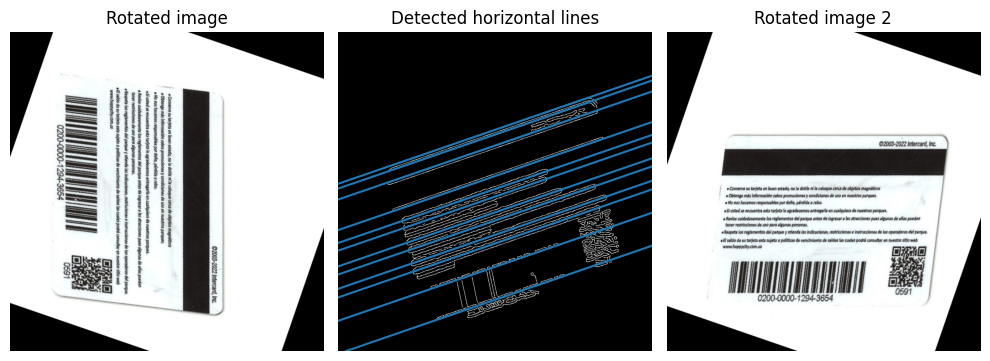

[92.5 92.5 92.5]
testing main   [92.5 92.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


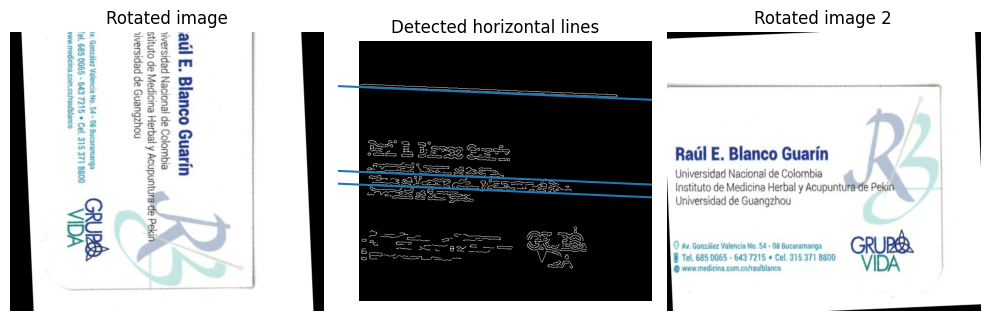

[86.]
testing main   [86.]


IndexError: index 1 is out of bounds for axis 0 with size 1

In [62]:
import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.feature import canny
from skimage import io, color, filters
import matplotlib.pyplot as plt
from matplotlib import cm
from sklearn.cluster import KMeans
import glob

# Function to rotate an image clockwise
def rotate_clockwise(image, degrees):
    height, width = image.shape[:2]
    center = (width / 2, height / 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, -degrees, 1.0)
    rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))
    return rotated_image

# Path to the folder containing the images
folder_path = "C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/"

# Get a list of image file paths in the folder
image_paths = glob.glob(folder_path + "*.jpeg")

# Process and display each image in the folder
for image_path in image_paths:
    # Load the source image
    image = io.imread(image_path)

    # Convert the image to grayscale
    image_gray = color.rgb2gray(image)

    # Apply Gaussian blur to reduce noise
    image_blurred = filters.gaussian(image_gray, sigma=1.5)

    # Apply horizontal Sobel filter
    image_edges_h = filters.sobel_h(image_blurred)

    # Perform Canny edge detection on horizontal Sobel output
    edges_h = canny(image_edges_h, sigma=1.8)

    # Perform Hough transform on the horizontal edges
    tested_angles_h = np.linspace(0, np.pi, 360, endpoint=False)
    h_h, theta_h, d_h = hough_line(edges_h, theta=tested_angles_h)

    # Extract prominent lines from the Hough accumulator using a threshold
    _, angles, distances = hough_line_peaks(h_h, theta_h, d_h, threshold=160)
    print(np.rad2deg(angles))

    # Perform K-means clustering to find the main angles
    if len(angles) > 1:
        kmeans = KMeans(n_clusters=2, random_state=0).fit(angles.reshape(-1, 1))
        main_angles = kmeans.cluster_centers_.flatten()
    else:
        main_angles = angles
    print('testing main  ', np.rad2deg(main_angles))
    main_angles = np.rad2deg(main_angles)

    # Rotate the image clockwise by the calculated angles
    rotated_image = rotate_clockwise(image, 180 - main_angles[1])
    rotated_image2 = rotate_clockwise(image, 90 - main_angles[0])

    # Plot the input image and the detected horizontal lines
    fig, axes = plt.subplots(1, 3, figsize=(10, 5))
    ax = axes.ravel()

    ax[0].imshow(rotated_image, cmap=cm.gray)  # Display the rotated image
    ax[0].set_title('Rotated image')
    ax[0].set_axis_off()

    ax[1].imshow(edges_h, cmap=cm.gray)
    ax[1].set_ylim((edges_h.shape[0], 0))
    ax[1].set_axis_off()
    ax[1].set_title('Detected horizontal lines')

    ax[2].imshow(rotated_image2, cmap=cm.gray)  # Display the rotated image
    ax[2].set_title('Rotated image 2')
    ax[2].set_axis_off()

    for angle, dist in zip(angles, distances):
        (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
        ax[1].axline((x0, y0), slope=np.tan(angle + np.pi / 2))

    plt.tight_layout()
    plt.show()


[91.  91.  91.5]
testing main   [91.  91.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


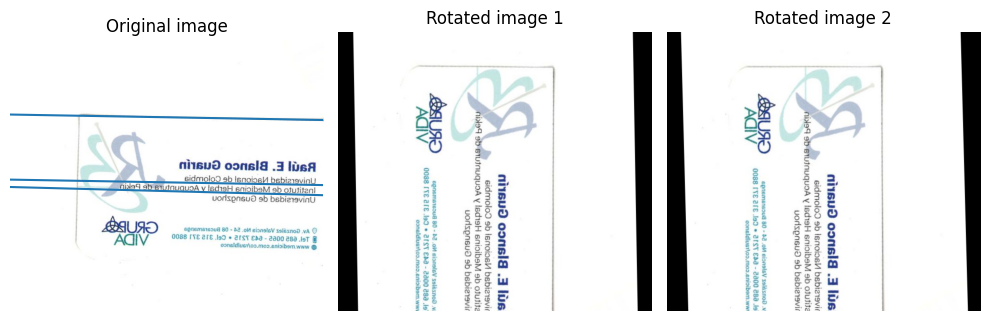

[152.5 152.5  64.5 152.5]
testing main   [ 64.5 152.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


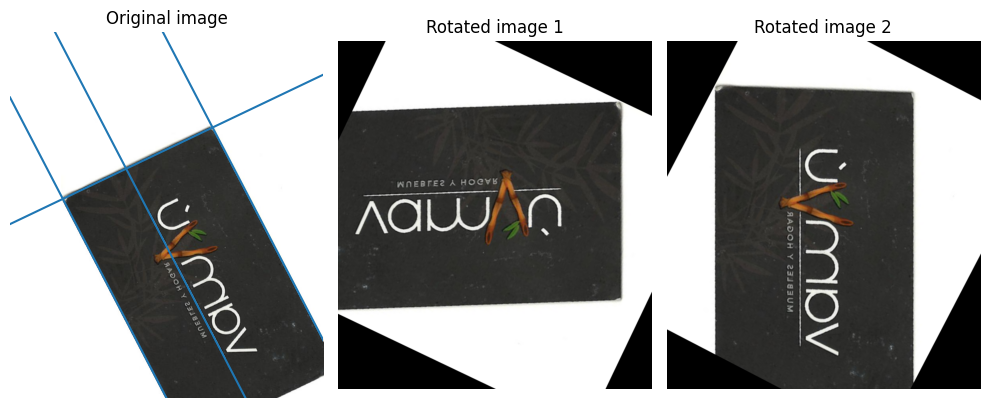

[136. 136.]
testing main   [136. 136.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


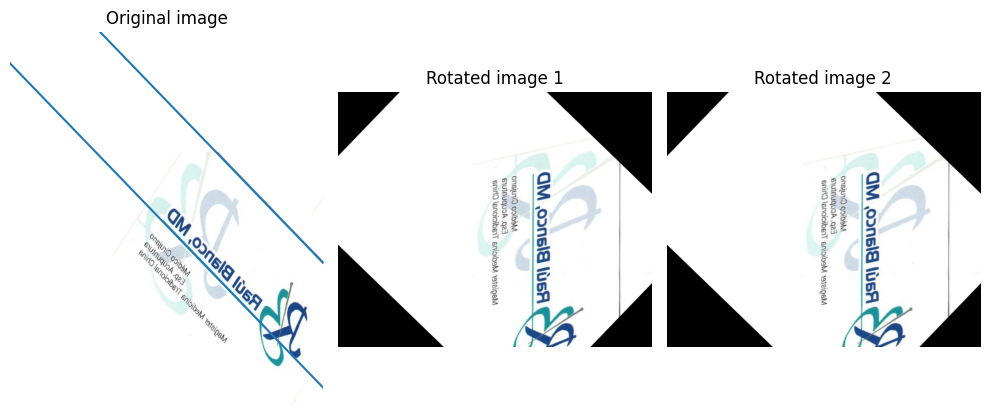

[ 48.5  48.5 132.  132.   48.5]
testing main   [132.   48.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


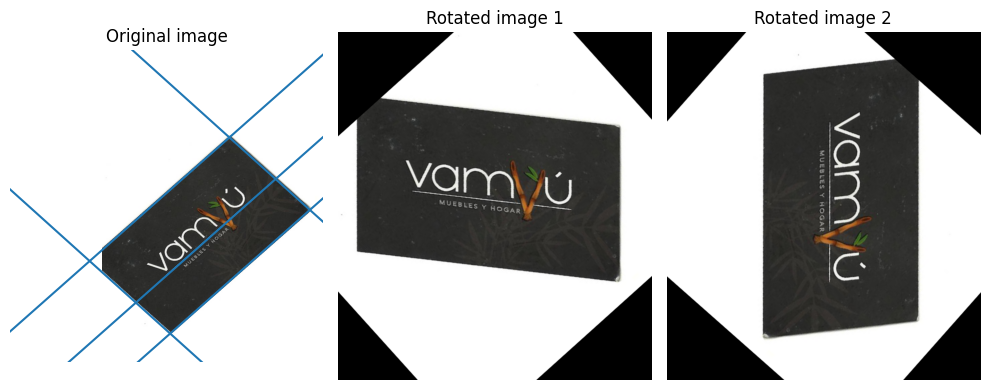

[148.5 148.5  54.5  55. ]
testing main   [ 54.75 148.5 ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


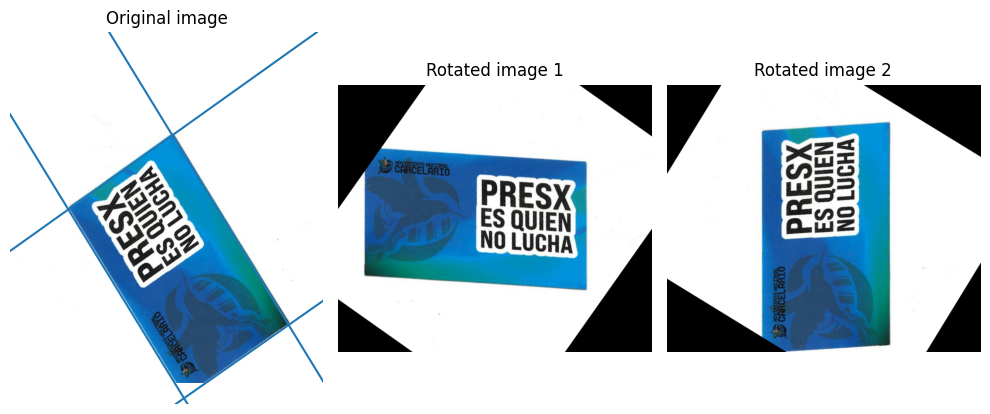

[83.5 83.5]
testing main   [83.5 83.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


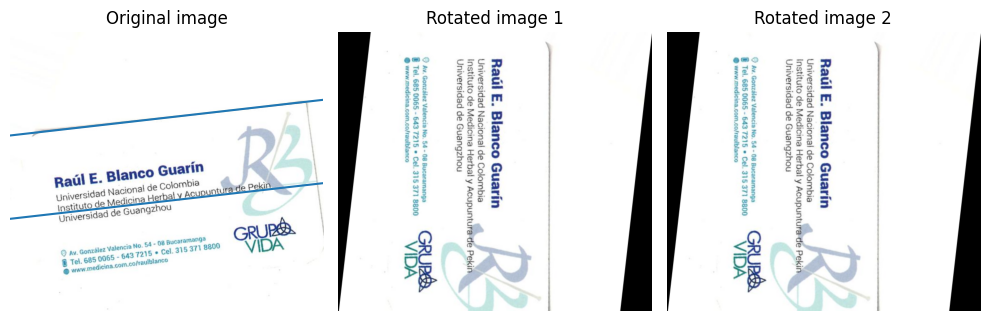

[71. 71. 71. 71. 71. 71. 71. 71. 71. 71. 71. 71.]
testing main   [71. 71.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


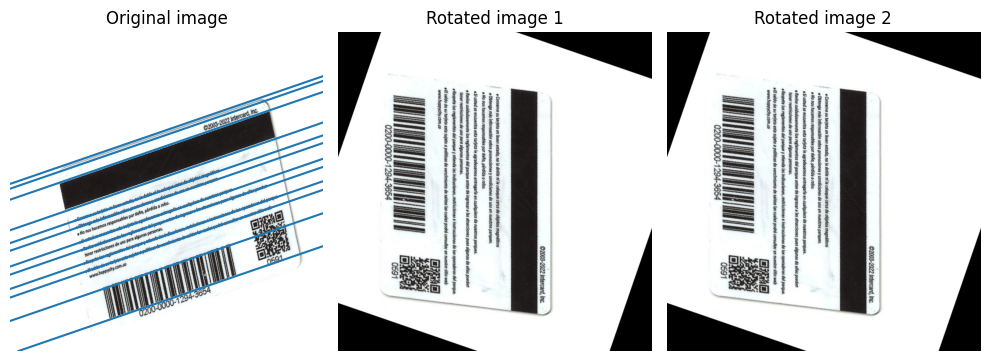

[92.5 92.5 92.5]
testing main   [92.5 92.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


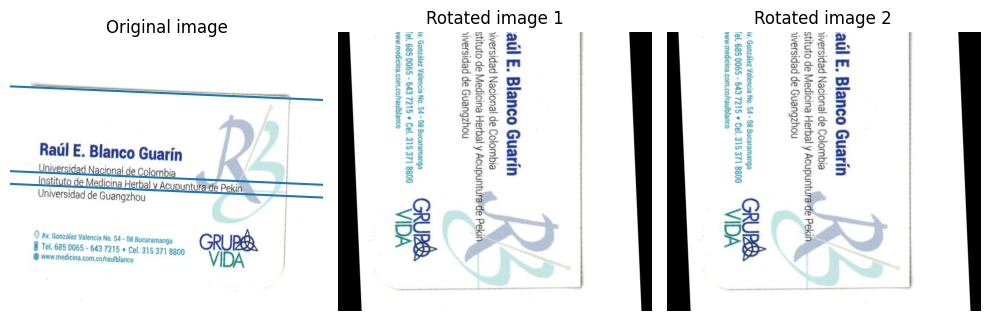

[86.]
testing main   [86.]


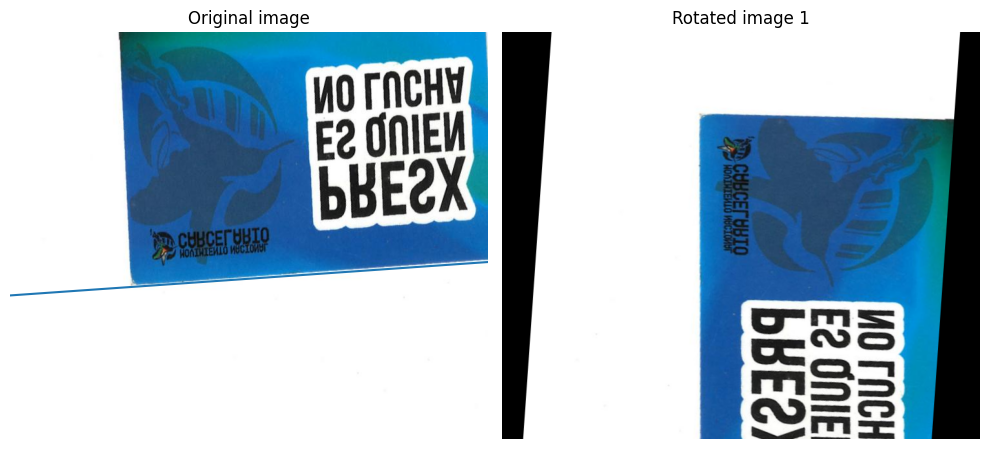

[114.5 114.5 114.5  41.  114.5 114.5 114.5 114.5 114.5 114.5 114.5]
testing main   [114.5  41. ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


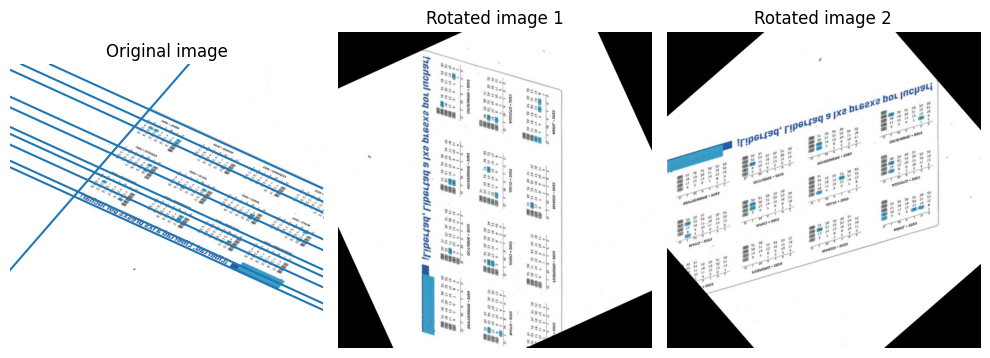

[99. 99.]
testing main   [99. 99.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


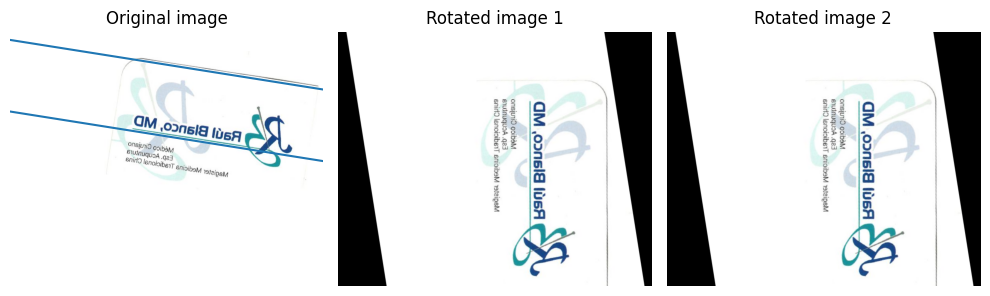

[125.5 125.5  34.5]
testing main   [125.5  34.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


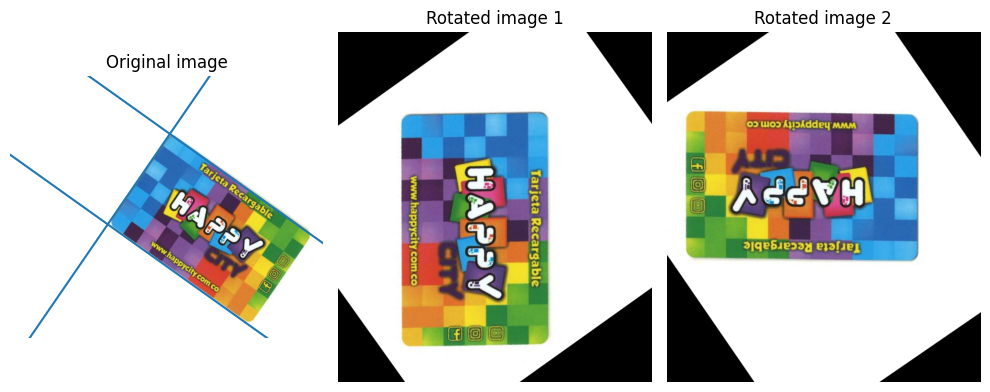

[ 59.   59.   59.   59.   58.5  59.   59.   59.   59.   59.   58.5 149. ]
testing main   [ 58.90909091 149.        ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


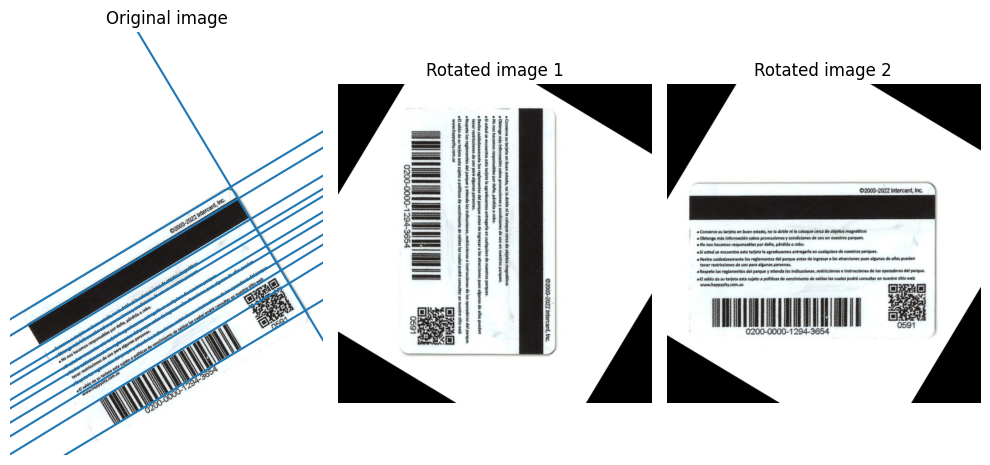

[87.]
testing main   [87.]


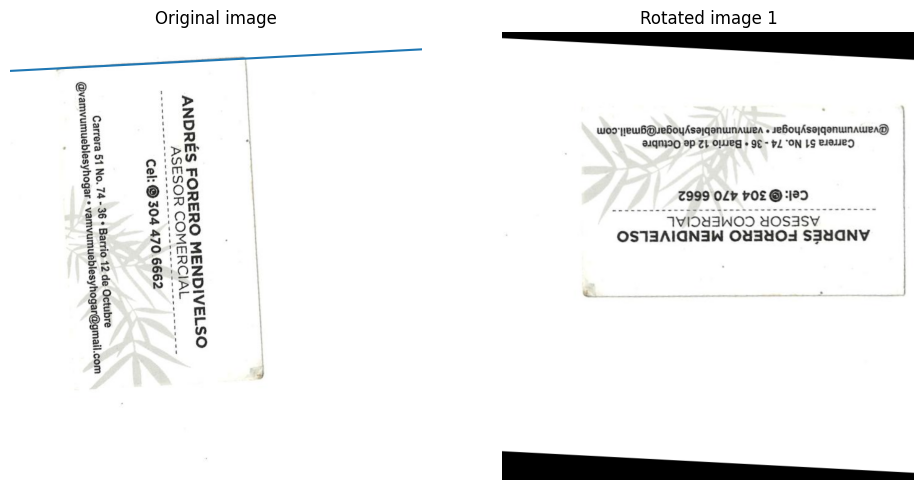

[84. 84.]
testing main   [84. 84.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


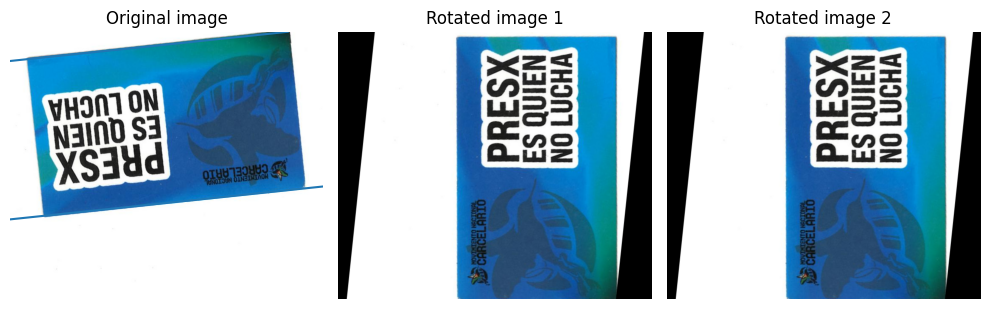

[ 57.  152.5 152.5 152.5 152.5]
testing main   [152.5  57. ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


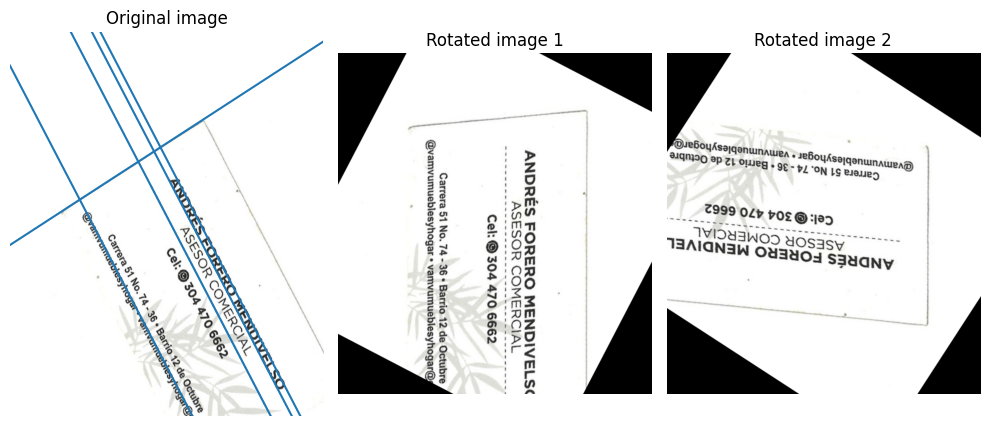

[ 63.  63. 154. 154.  63.]
testing main   [154.  63.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


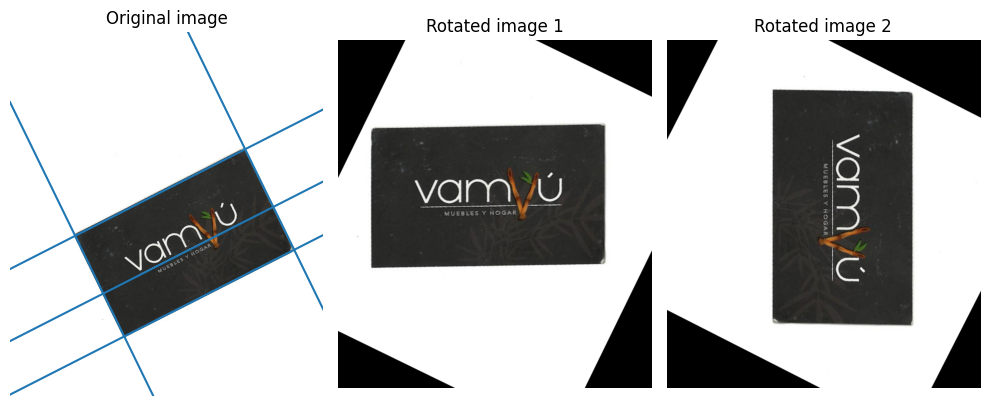

[76.5 76.5 76.5]
testing main   [76.5 76.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


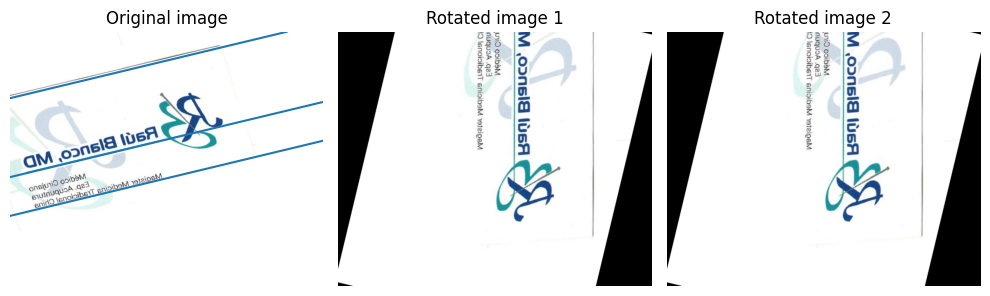

[59.  59.5 59.5 59.5]
testing main   [59.5 59. ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


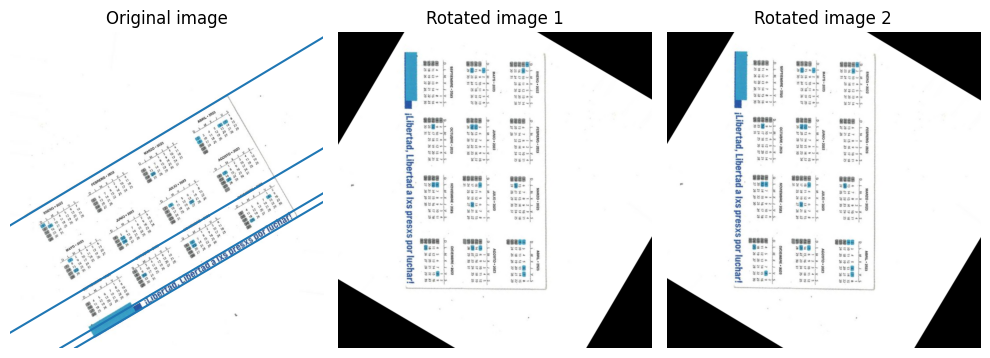

[ 47.  47. 140. 140.]
testing main   [140.  47.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


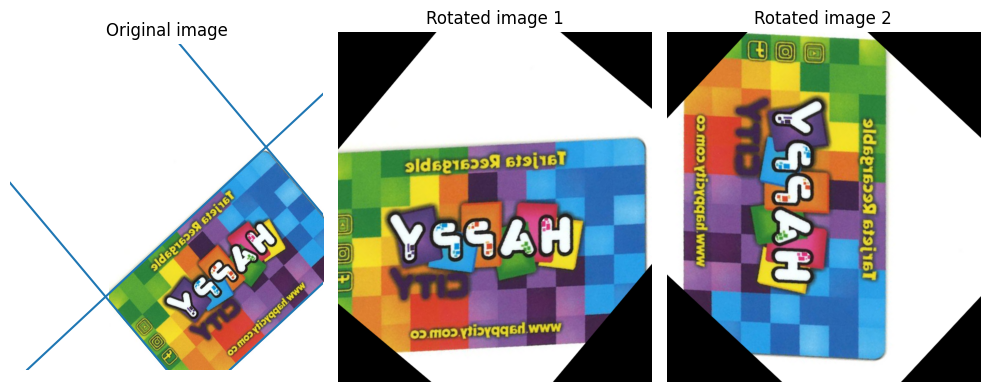

[102.5  20.5]
testing main   [ 20.5 102.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


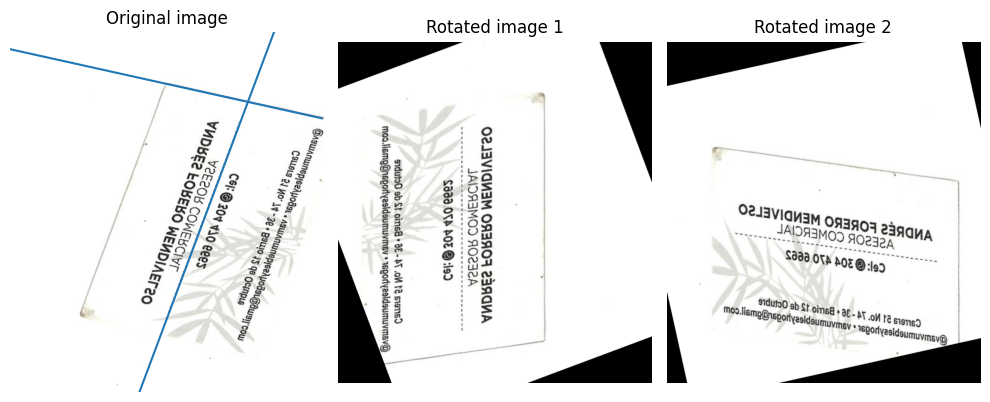

[75.]
testing main   [75.]


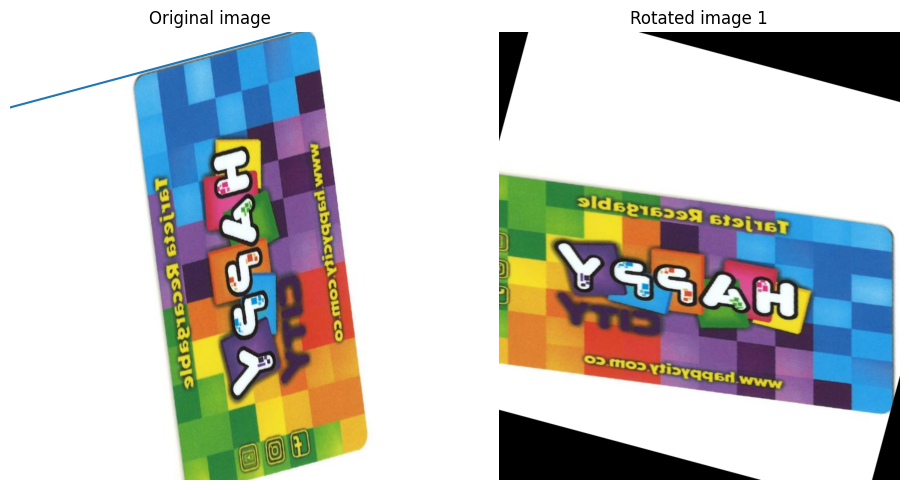

[119. 119. 119.  32.  32.]
testing main   [119.  32.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


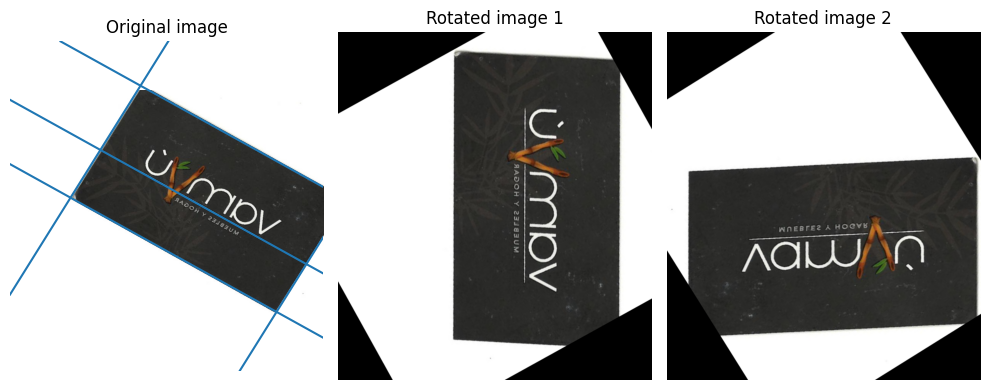

[78.  78.  78.5 78.5 78.  78. ]
testing main   [78.5 78. ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


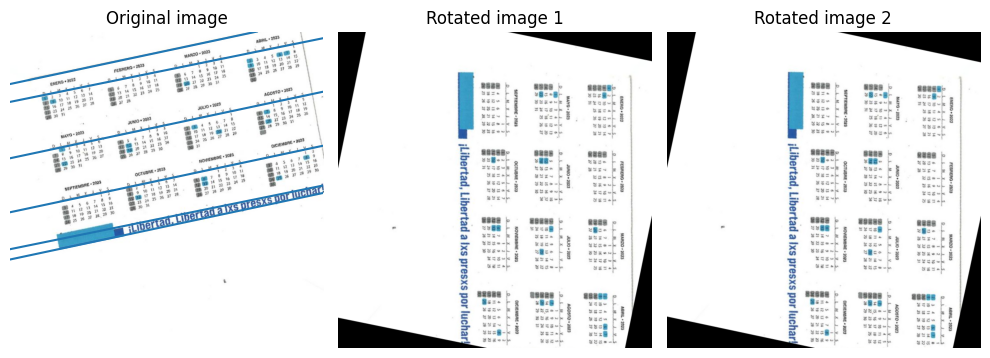

[84.]
testing main   [84.]


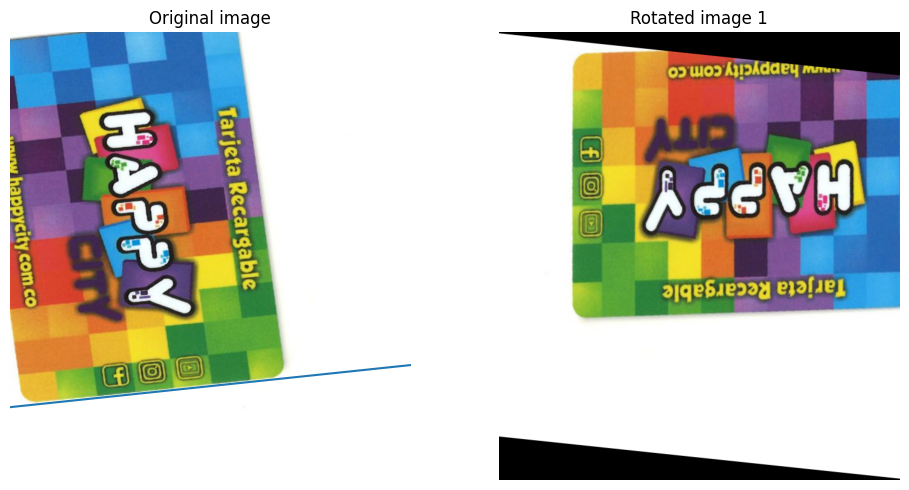

[147.5  59.  147.5 147.5 148.5]
testing main   [147.75  59.  ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


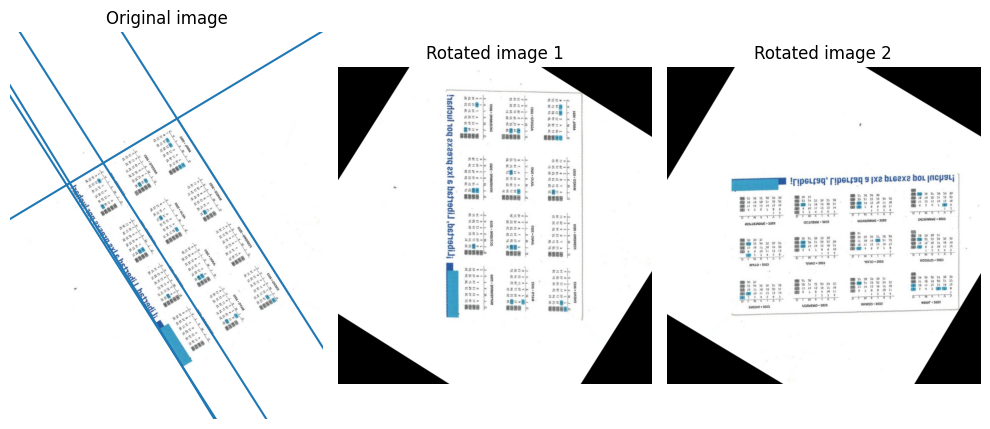

[96.5]
testing main   [96.5]


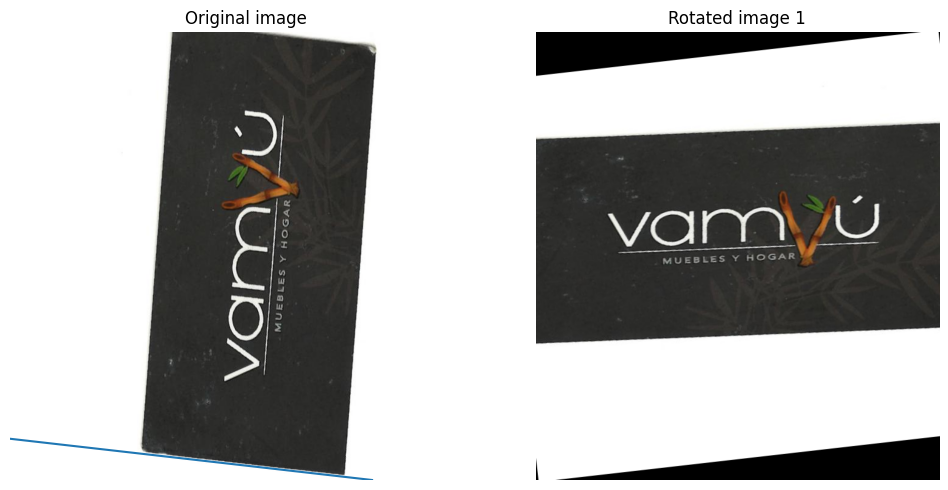

[12.5]
testing main   [12.5]


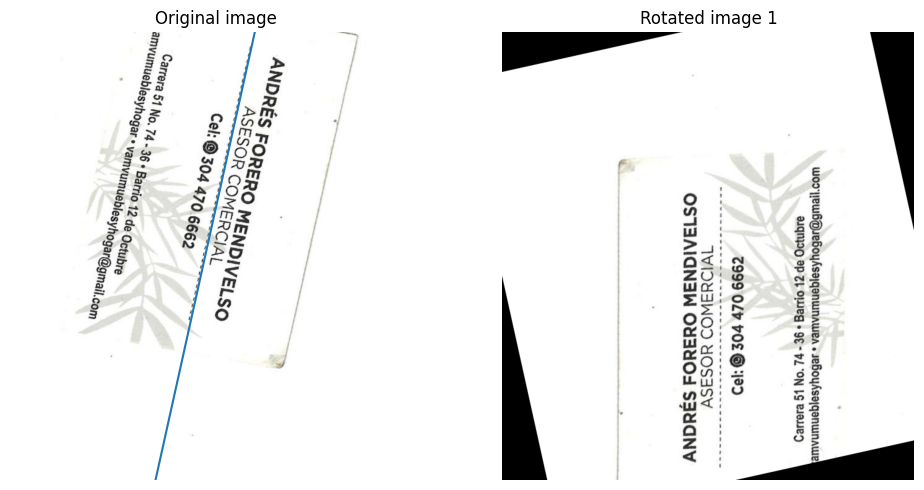

[94. 94.]
testing main   [94. 94.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


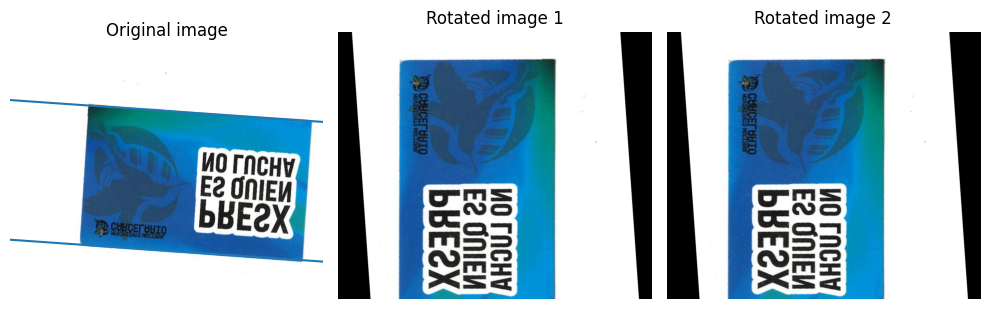

[151.5  47. ]
testing main   [ 47.  151.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


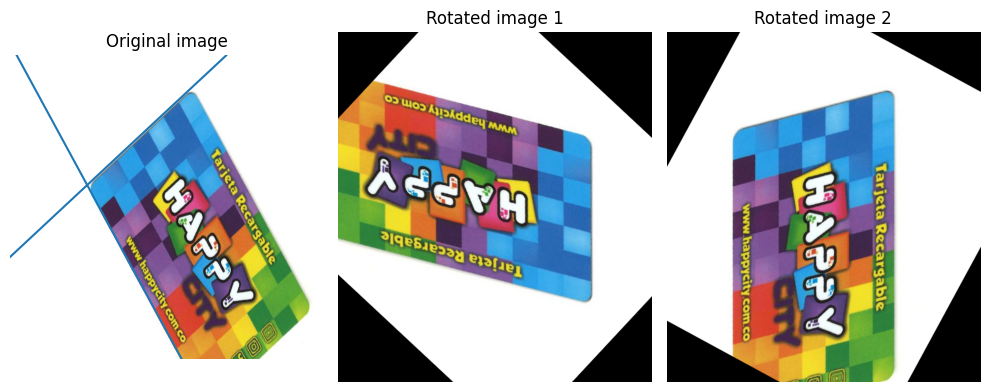

[92.5]
testing main   [92.5]


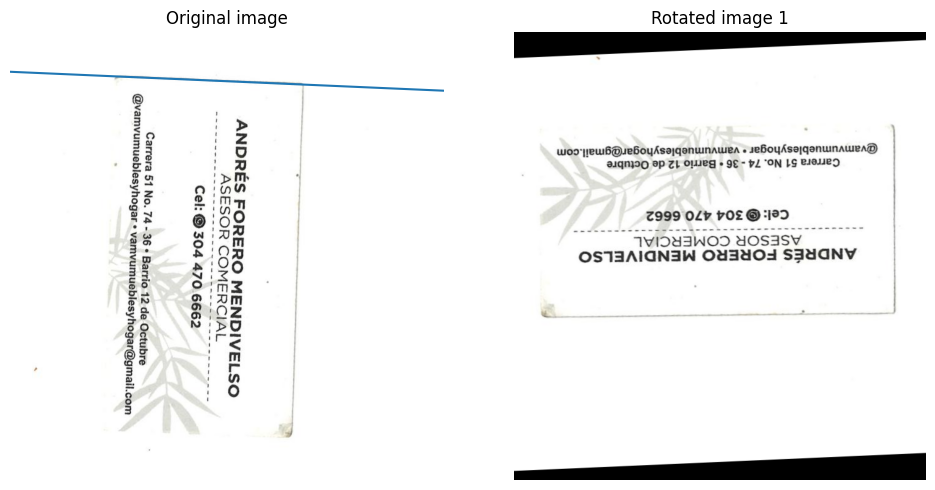

[80. 80. 80.]
testing main   [80. 80.]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


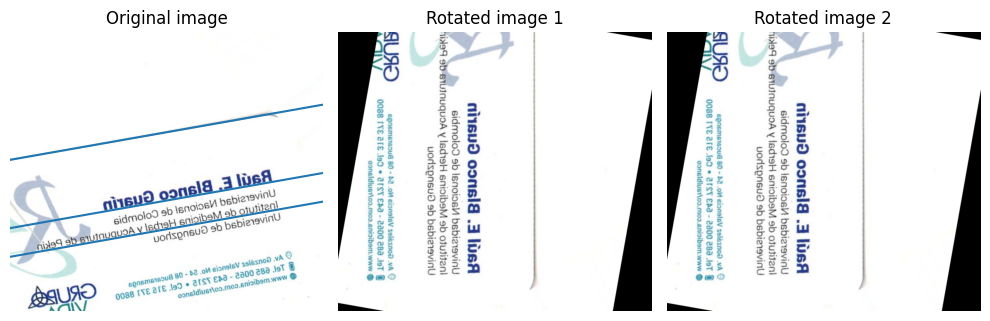

[61.5]
testing main   [61.5]


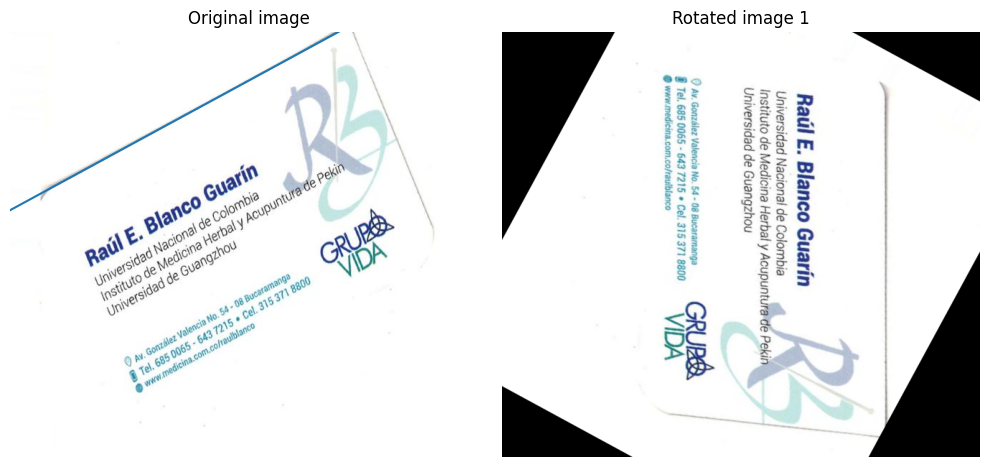

[128.5 128.5]
testing main   [128.5 128.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


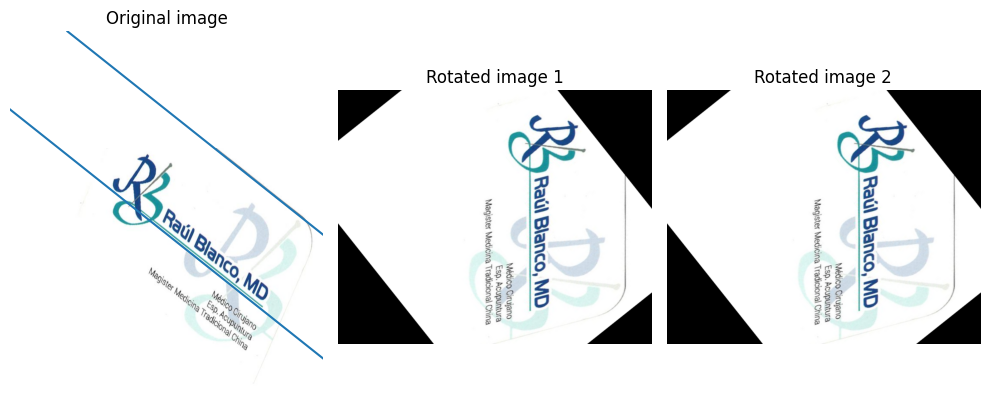

[131.5 131.5 131.5 131.5 131.5 131.5 131.5 131.5 131.5  36.5 131.5]
testing main   [131.5  36.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


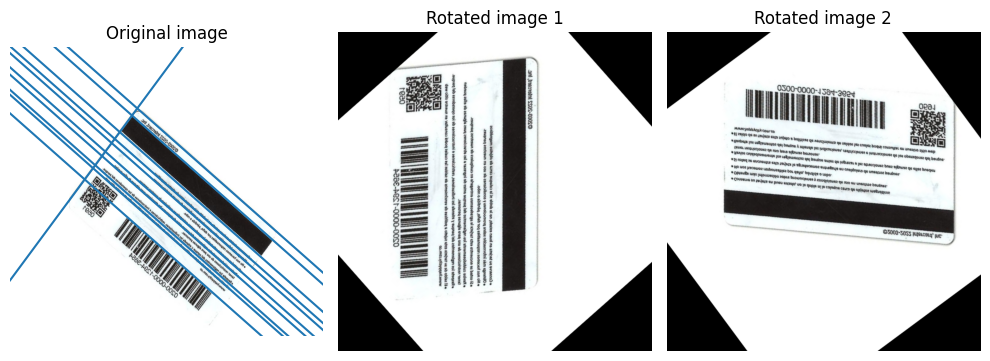

[138.  138.  138.  138.  138.  138.  138.  138.  138.   54.5 138.  138.
 135.  135.  135.  132.  126.5]
testing main   [ 54.5     136.34375]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


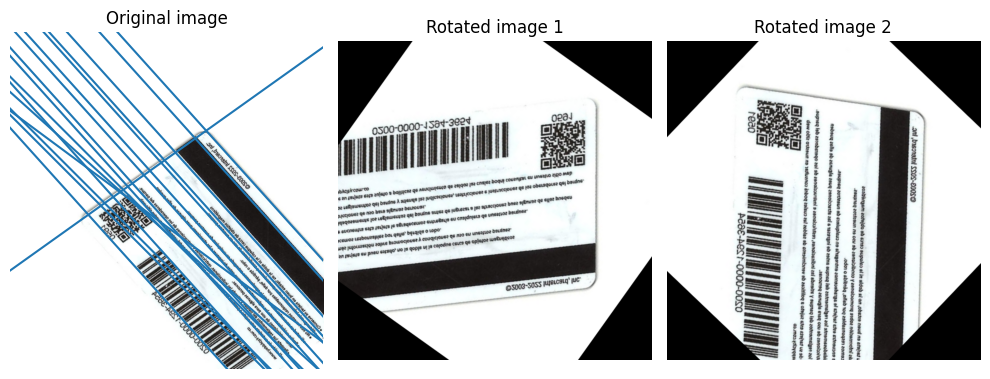

[103.  102.5 102.5 102.5 102.5 102.5]
testing main   [102.5 103. ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


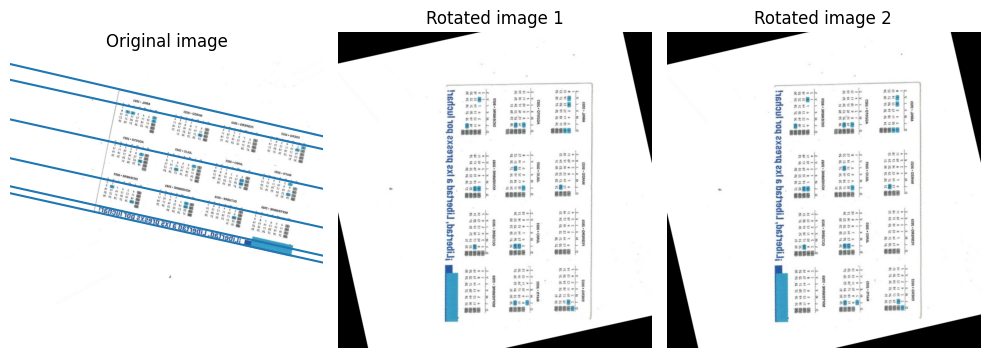

[145.  145.  145.  145.  145.  145.  145.  145.  145.   55.5  55.  135.
 135.  135.  135.  135. ]
testing main   [141.42857143  55.25      ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


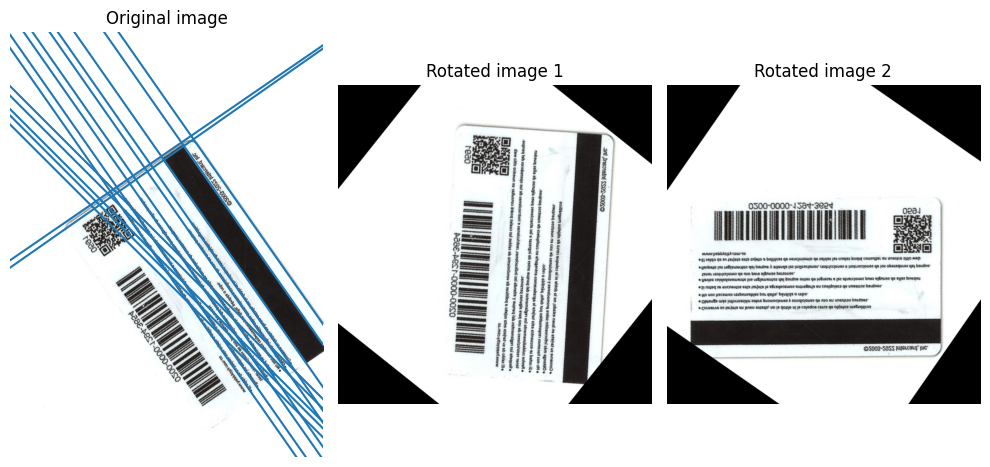

[111.5 111.5 111.5]
testing main   [111.5 111.5]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


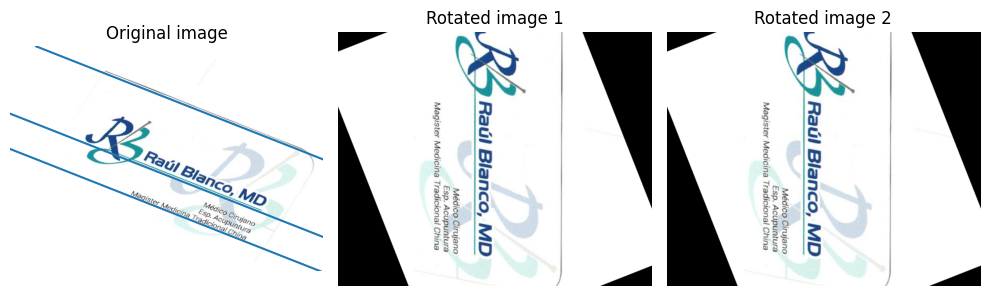

[148.  148.   56.5 148. ]
testing main   [ 56.5 148. ]


C:\Users\rugel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


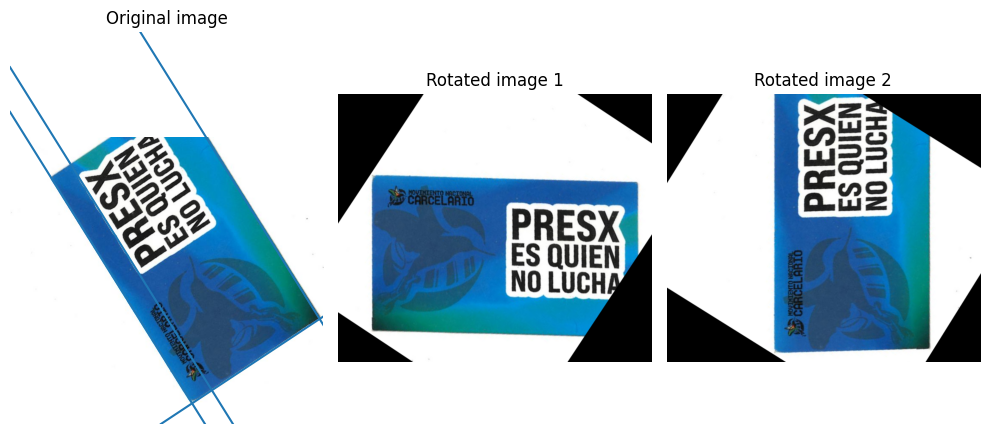

In [63]:
import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.feature import canny
from skimage import io, color, filters
import matplotlib.pyplot as plt
from matplotlib import cm
from sklearn.cluster import KMeans
import glob

# Function to rotate an image clockwise
def rotate_clockwise(image, degrees):
    height, width = image.shape[:2]
    center = (width / 2, height / 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, -degrees, 1.0)
    rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))
    return rotated_image

# Path to the folder containing the images
folder_path = "C:/Users/rugel/OneDrive - UNIVERSIDAD INDUSTRIAL DE SANTANDER/UNIVERSIDAD/LEARNING PYTHON/ProyectoCV/scanaugm/"

# Get a list of image file paths in the folder
image_paths = glob.glob(folder_path + "*.jpeg")

# Process and display each image in the folder
for image_path in image_paths:
    # Load the source image
    image = io.imread(image_path)

    # Convert the image to grayscale
    image_gray = color.rgb2gray(image)

    # Apply Gaussian blur to reduce noise
    image_blurred = filters.gaussian(image_gray, sigma=1.5)

    # Apply horizontal Sobel filter
    image_edges_h = filters.sobel_h(image_blurred)

    # Perform Canny edge detection on horizontal Sobel output
    edges_h = canny(image_edges_h, sigma=1.8)

    # Perform Hough transform on the horizontal edges
    tested_angles_h = np.linspace(0, np.pi, 360, endpoint=False)
    h_h, theta_h, d_h = hough_line(edges_h, theta=tested_angles_h)

    # Extract prominent lines from the Hough accumulator using a threshold
    _, angles, distances = hough_line_peaks(h_h, theta_h, d_h, threshold=160)
    print(np.rad2deg(angles))

    # Perform K-means clustering to find the main angles
    if len(angles) > 1:
        kmeans = KMeans(n_clusters=2, random_state=0).fit(angles.reshape(-1, 1))
        main_angles = kmeans.cluster_centers_.flatten()
    else:
        main_angles = angles
    print('testing main  ', np.rad2deg(main_angles))
    main_angles = np.rad2deg(main_angles)

    # Rotate the image for each main angle
    rotated_images = []
    for main_angle in main_angles:
        rotated_image = rotate_clockwise(image, 180 - main_angle)
        rotated_images.append(rotated_image)

    # Plot the input image and the detected horizontal lines
    num_images = len(rotated_images)
    fig, axes = plt.subplots(1, num_images + 1, figsize=(10, 5))
    ax = axes.ravel()

    ax[0].imshow(image, cmap=cm.gray)  # Display the original image
    ax[0].set_title('Original image')
    ax[0].set_axis_off()

    for i in range(num_images):
        ax[i + 1].imshow(rotated_images[i], cmap=cm.gray)  # Display the rotated image
        ax[i + 1].set_title(f'Rotated image {i + 1}')
        ax[i + 1].set_axis_off()

    for angle, dist in zip(angles, distances):
        (x0, y0) = dist * np.array([np.cos(angle), np.sin(angle)])
        ax[0].axline((x0, y0), slope=np.tan(angle + np.pi / 2))

    plt.tight_layout()
    plt.show()
